In [1]:
!pip install kaleido

Defaulting to user installation because normal site-packages is not writeable


In [2]:
!pip install fastparquet

Defaulting to user installation because normal site-packages is not writeable


In [3]:
!pip install pyarrow

Defaulting to user installation because normal site-packages is not writeable


In [4]:
import pandas as pd
import numpy as np
import plotly.express as px
from plotly.subplots import make_subplots
import plotly.graph_objects as go

from matplotlib import pyplot as plt
import seaborn as sns

import os, sys
import gc
import json
module_path = os.path.abspath(os.path.join(".."))
if module_path not in sys.path:
    sys.path.append(module_path)

from lib.graphUtils import (
    show_pie,
    show_lines,
    show_cols_boxplots_by_col,
)

from lib.dfInfo import show_df_info_bar, get_df_info

from sklearn.preprocessing import OneHotEncoder
from sklearn.feature_selection import r_regression

import plotly.io as pio
pio.kaleido.scope.default_format = "png"
pio.renderers.default = "png"

In [5]:
pd.set_option("display.max_rows", None, "display.max_columns", None, "display.max_colwidth", None)


In [6]:
cols_to_remove = {}
filled_ratio_threshold = 50
nb_total_features = 0

# Structure des données

<img src="https://storage.googleapis.com/kaggle-media/competitions/home-credit/home_credit.png"></img>

# bureau_balance

In [7]:
df_bureau_balance = pd.read_csv("../assets/bureau_balance.csv")
nb_total_features += df_bureau_balance.shape[1]
df_bureau_balance.head()


,SK_ID_BUREAU,MONTHS_BALANCE,STATUS
0,5715448,0,C
1,5715448,-1,C
2,5715448,-2,C
3,5715448,-3,C
4,5715448,-4,C


In [8]:
df_bureau_balance.info(verbose=True, show_counts=True)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 27299925 entries, 0 to 27299924
Data columns (total 3 columns):
 #   Column          Non-Null Count     Dtype 
---  ------          --------------     ----- 
 0   SK_ID_BUREAU    27299925 non-null  int64 
 1   MONTHS_BALANCE  27299925 non-null  int64 
 2   STATUS          27299925 non-null  object
dtypes: int64(2), object(1)
memory usage: 624.8+ MB


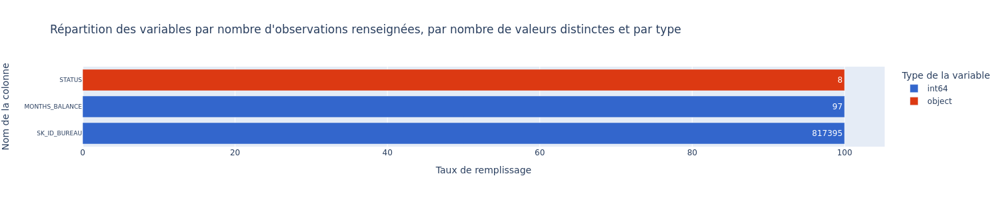

In [9]:
show_df_info_bar(df_bureau_balance, width=1500)

In [10]:
df_info = get_df_info(df_bureau_balance)
if df_info.loc[df_info["filled_ratio"]<filled_ratio_threshold, "column"].shape[0]>0:
    if "bureau_balance" not in cols_to_remove:
        cols_to_remove["bureau_balance"] = []
    for c in df_info.loc[df_info["filled_ratio"]<filled_ratio_threshold, "column"]:
        cols_to_remove["bureau_balance"].append(c)

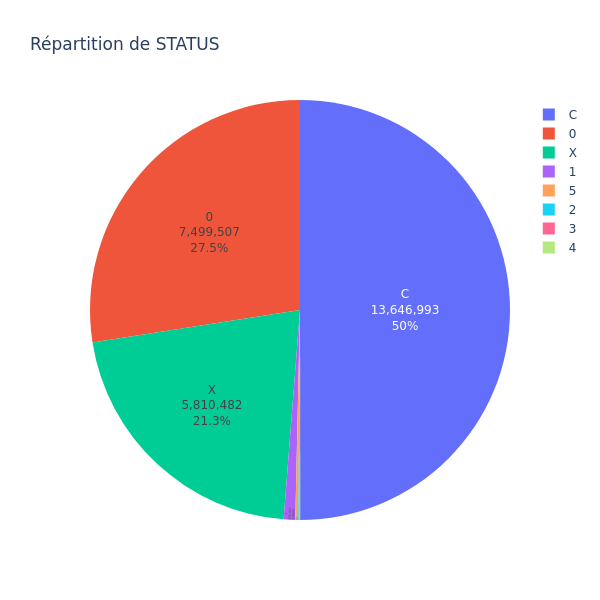

In [11]:
fig = px.pie(df_bureau_balance.groupby("STATUS").size().reset_index(name="nb"), values="nb", names="STATUS", title="Répartition de STATUS")
fig.update_traces(textposition='inside', textinfo='percent+label+value')
fig.update_layout(width=600, height=600)
fig.show()

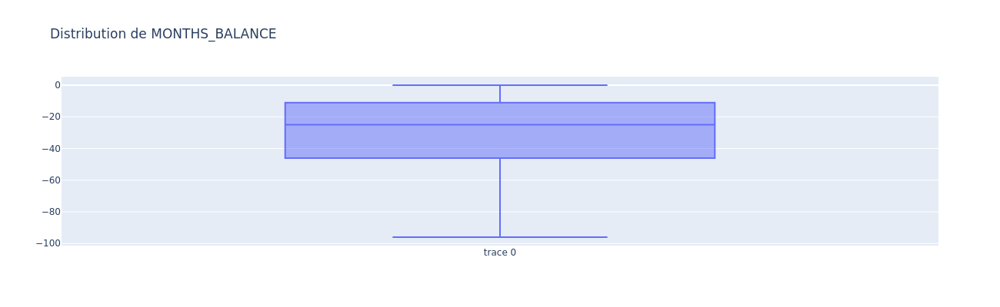

In [12]:
fig = go.Figure()

fig.add_trace(go.Box(y=df_bureau_balance["MONTHS_BALANCE"]))

fig.update_layout(height=400, width=1300, title_text=f"Distribution de MONTHS_BALANCE")
fig.show()

In [13]:
del df_bureau_balance
gc.collect()

722

# bureau

In [14]:
df_bureau = pd.read_csv("../assets/bureau.csv")
df_bureau.head()
nb_total_features += df_bureau.shape[1]

In [15]:
df_bureau.info(verbose=True, show_counts=True)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1716428 entries, 0 to 1716427
Data columns (total 17 columns):
 #   Column                  Non-Null Count    Dtype  
---  ------                  --------------    -----  
 0   SK_ID_CURR              1716428 non-null  int64  
 1   SK_ID_BUREAU            1716428 non-null  int64  
 2   CREDIT_ACTIVE           1716428 non-null  object 
 3   CREDIT_CURRENCY         1716428 non-null  object 
 4   DAYS_CREDIT             1716428 non-null  int64  
 5   CREDIT_DAY_OVERDUE      1716428 non-null  int64  
 6   DAYS_CREDIT_ENDDATE     1610875 non-null  float64
 7   DAYS_ENDDATE_FACT       1082775 non-null  float64
 8   AMT_CREDIT_MAX_OVERDUE  591940 non-null   float64
 9   CNT_CREDIT_PROLONG      1716428 non-null  int64  
 10  AMT_CREDIT_SUM          1716415 non-null  float64
 11  AMT_CREDIT_SUM_DEBT     1458759 non-null  float64
 12  AMT_CREDIT_SUM_LIMIT    1124648 non-null  float64
 13  AMT_CREDIT_SUM_OVERDUE  1716428 non-null  float64
 14  CR

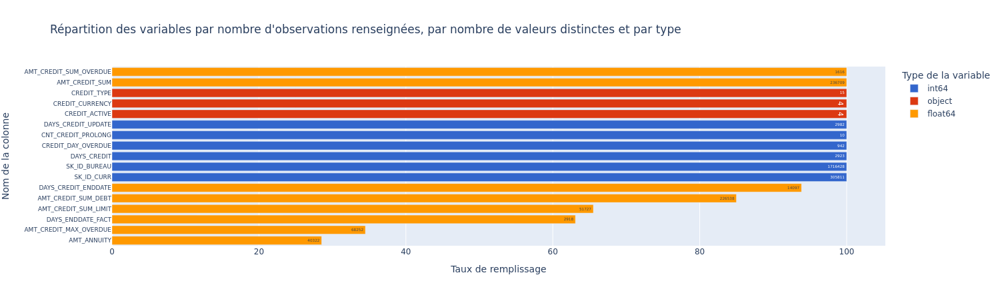

In [16]:
show_df_info_bar(df_bureau, width=1500)

In [17]:
df_info = get_df_info(df_bureau)
if df_info.loc[df_info["filled_ratio"]<filled_ratio_threshold, "column"].shape[0]>0:
    if "bureau" not in cols_to_remove:
        cols_to_remove["bureau"] = []
    for c in df_info.loc[df_info["filled_ratio"]<filled_ratio_threshold, "column"]:
        cols_to_remove["bureau"].append(c)

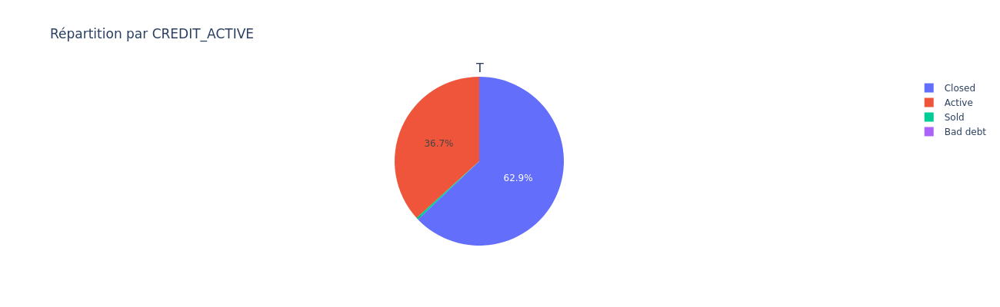

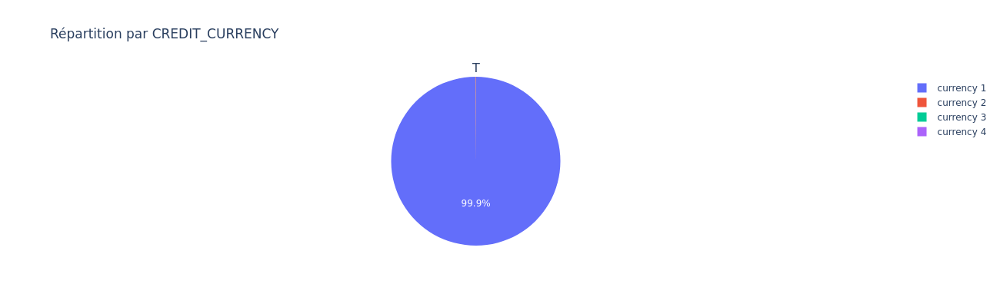

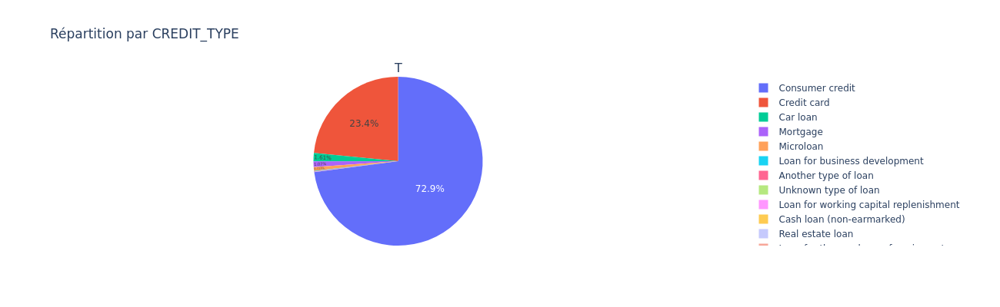

In [18]:
cat_cols = df_bureau.select_dtypes(include=[object]).columns
for y in range(1, len(cat_cols) + 1):
    fig = make_subplots(
        rows=1, 
        cols=1, 
        subplot_titles=("TOUS"),
        specs=[[{"type": "pie"}]]
    )


            
    
    vc = df_bureau.groupby(cat_cols[y-1]).count().reset_index()
    fig.append_trace(go.Pie(
        labels=vc.iloc[:,0], 
        values=vc.iloc[:,1],
        textposition='inside'
    ), row=1, col=1)

    
    fig.update_layout(height=400, width=1300, title_text=f"Répartition par {cat_cols[y-1]}")
    fig.show()

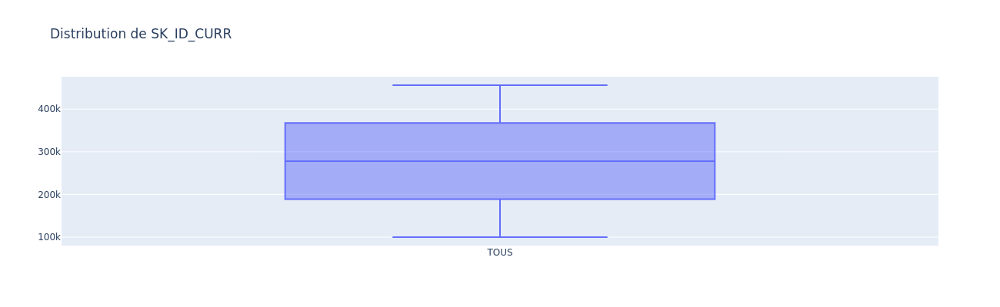

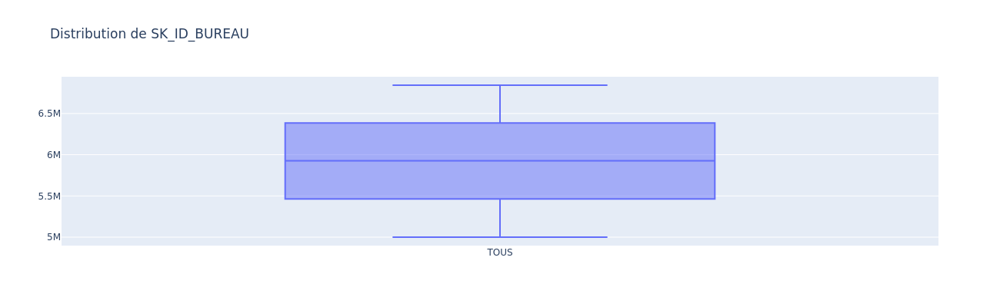

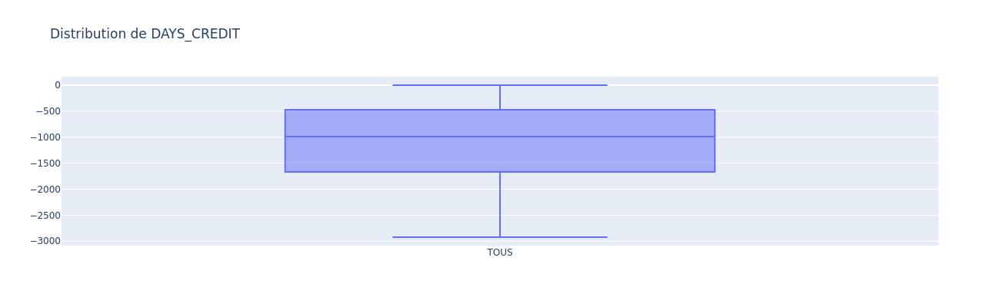

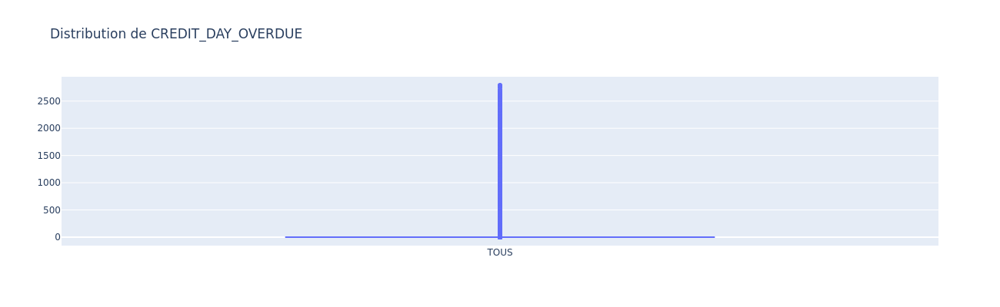

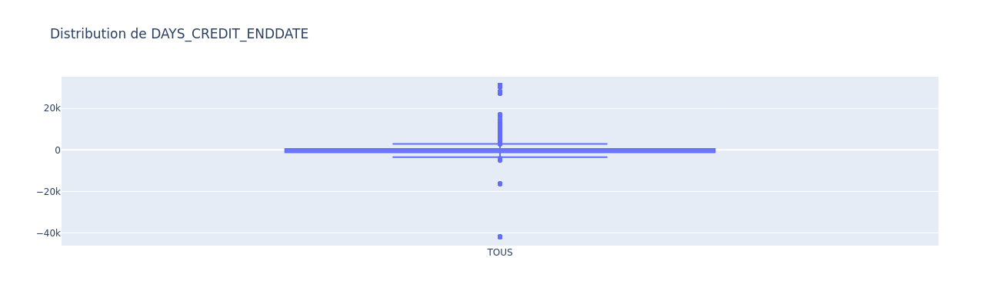

...

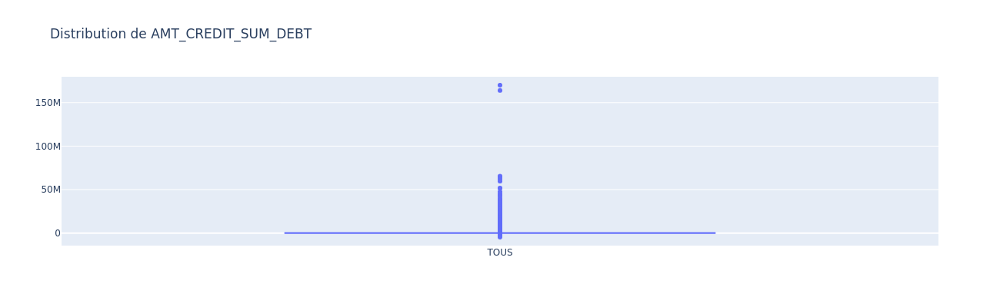

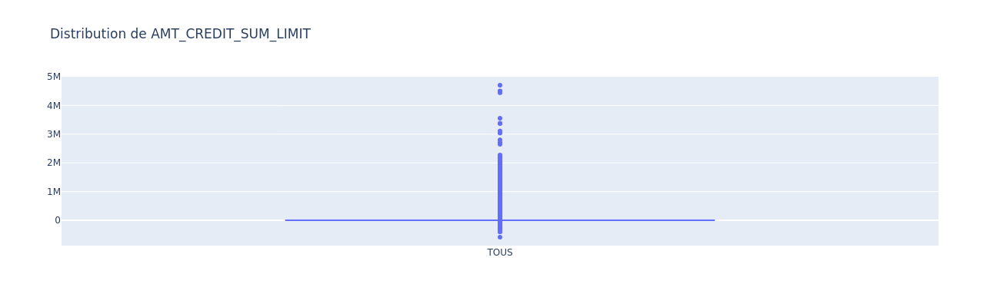

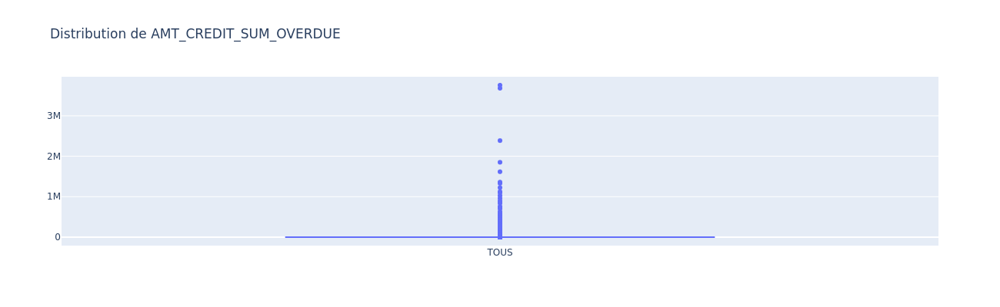

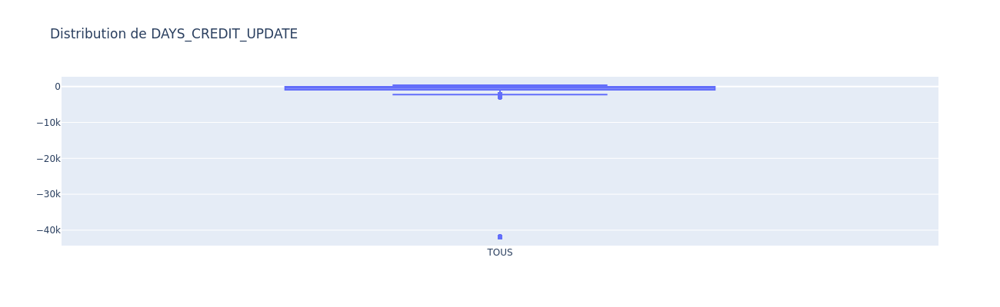

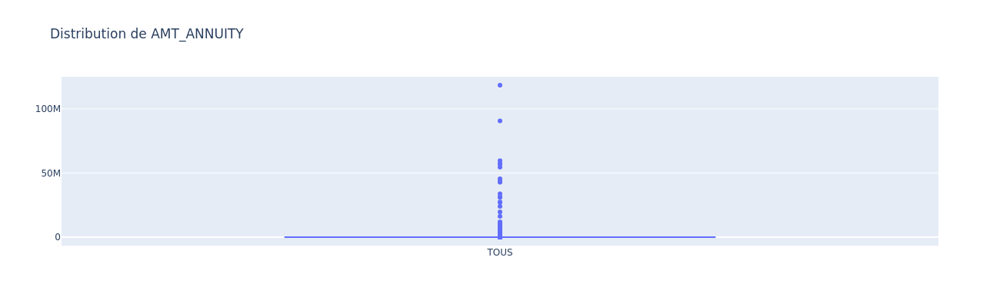

In [19]:
num_cols = df_bureau.select_dtypes(include=[int, float]).columns

for y in range(0, len(num_cols)):
    if num_cols[y]=="TARGET":
        continue
    #fig = make_subplots(rows=2, cols=2)
  
    fig = go.Figure()


    fig.add_trace(go.Box(y=df_bureau[num_cols[y]], name="TOUS"))
    fig.update_layout(height=400, width=1300, title_text=f"Distribution de {num_cols[y]}")
    
    fig.show()

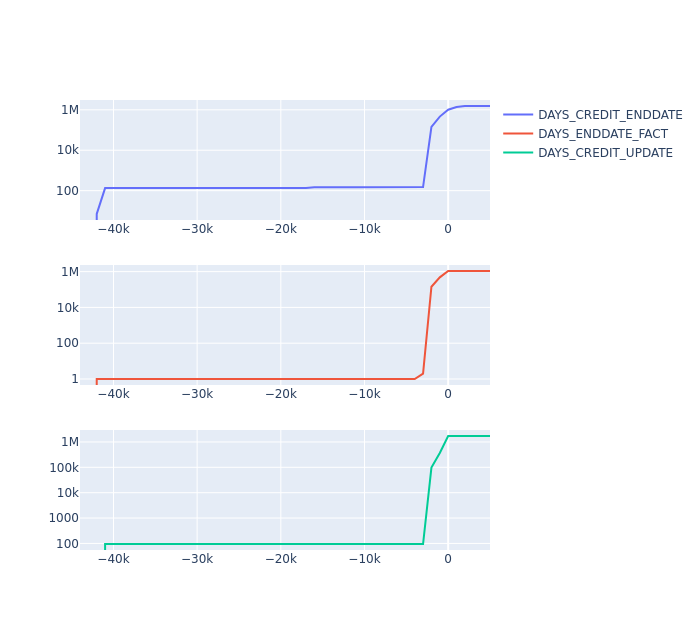

In [20]:
y_lines = {"DAYS_CREDIT_ENDDATE": [], "DAYS_ENDDATE_FACT": [], "DAYS_CREDIT_UPDATE": []}
x_lines = []
for x in range(5000, -45000, -1000):
    x_lines.append(x)
    y_lines["DAYS_CREDIT_ENDDATE"].append(df_bureau.loc[df_bureau["DAYS_CREDIT_ENDDATE"]<x].sort_values("DAYS_CREDIT_ENDDATE", ascending=False).shape[0])
    y_lines["DAYS_ENDDATE_FACT"].append(df_bureau.loc[df_bureau["DAYS_ENDDATE_FACT"]<x].sort_values("DAYS_ENDDATE_FACT", ascending=False).shape[0])
    y_lines["DAYS_CREDIT_UPDATE"].append(df_bureau.loc[df_bureau["DAYS_CREDIT_UPDATE"]<x].sort_values("DAYS_CREDIT_UPDATE", ascending=False).shape[0])

show_lines(x_lines, y_lines, y_log=True)


On constate des valeurs pour les nombres de jours relatifs aux crédits qui vont au delà de 20000 jours en valeurs absolue.

Or 20000/365=54 ans, ce qui est peu probable. On va dons remplacer les valeurs en deça de -20000 par NAN

In [21]:
df_bureau.loc[df_bureau["DAYS_CREDIT_ENDDATE"]<-20000, "DAYS_CREDIT_ENDDATE"] = np.NaN
df_bureau.loc[df_bureau["DAYS_ENDDATE_FACT"]<-20000, "DAYS_ENDDATE_FACT"] = np.NaN
df_bureau.loc[df_bureau["DAYS_CREDIT_UPDATE"]<-20000, "DAYS_CREDIT_UPDATE"] = np.NaN


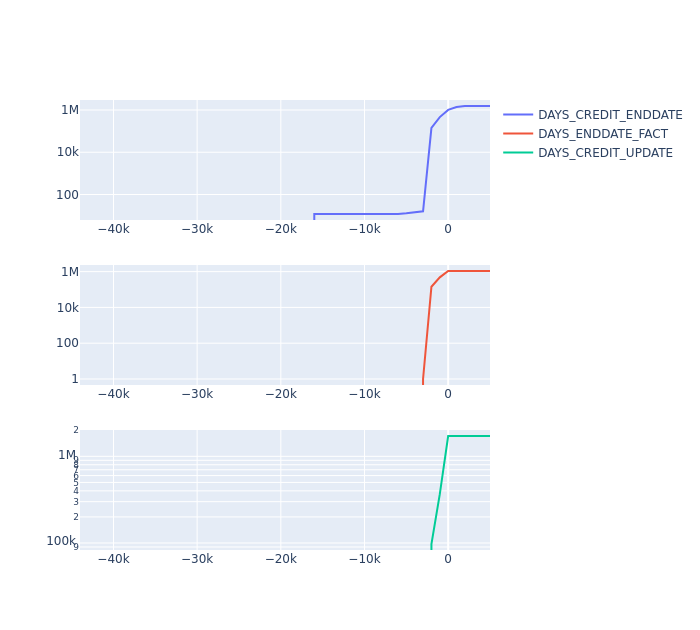

In [22]:
y_lines = {"DAYS_CREDIT_ENDDATE": [], "DAYS_ENDDATE_FACT": [], "DAYS_CREDIT_UPDATE": []}
x_lines = []
for x in range(5000, -45000, -1000):
    x_lines.append(x)
    y_lines["DAYS_CREDIT_ENDDATE"].append(df_bureau.loc[df_bureau["DAYS_CREDIT_ENDDATE"]<x].sort_values("DAYS_CREDIT_ENDDATE", ascending=False).shape[0])
    y_lines["DAYS_ENDDATE_FACT"].append(df_bureau.loc[df_bureau["DAYS_ENDDATE_FACT"]<x].sort_values("DAYS_ENDDATE_FACT", ascending=False).shape[0])
    y_lines["DAYS_CREDIT_UPDATE"].append(df_bureau.loc[df_bureau["DAYS_CREDIT_UPDATE"]<x].sort_values("DAYS_CREDIT_UPDATE", ascending=False).shape[0])

show_lines(x_lines, y_lines, y_log=True)


['DAYS_ENDDATE_FACT', 'DAYS_CREDIT_UPDATE']


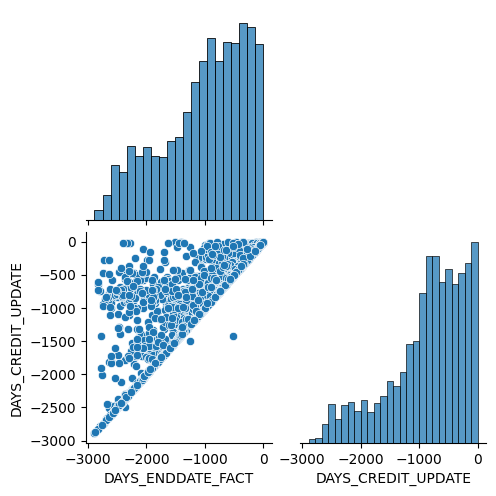

In [23]:

num_cols = [c for c in df_bureau.drop(columns=cols_to_remove["bureau"]).select_dtypes(include=np.float64).columns.tolist() if c not in ['SK_ID_CURR', 'SK_ID_BUREAU']]
df_bureau2 = df_bureau.drop(columns=cols_to_remove["bureau"]).dropna()
relations = []
for c in num_cols:
    df2 = df_bureau2.loc[:, [x for x in num_cols if x!=c]]
    r = r_regression(df2, df_bureau2[c])
    for i in range(0, len(r)):
        if r[i]>0.7:
            relations.append(c)
            relations.append(df2.columns[i])

relations = list(set(relations))

print(relations)

if len(relations)>0:
    sns.pairplot(
        df_bureau.sample(n=5000).loc[:, relations ].dropna(),
        dropna=True,
        corner=True
    )
    plt.show()
else:
    print("pas de relation linéaire détectée")


In [24]:
del df_bureau
gc.collect()

1179

# credit_card_balance

In [25]:
df_credit_card_balance = pd.read_csv("../assets/credit_card_balance.csv")
nb_total_features += df_credit_card_balance.shape[1]
df_credit_card_balance.head()


,SK_ID_PREV,SK_ID_CURR,MONTHS_BALANCE,AMT_BALANCE,AMT_CREDIT_LIMIT_ACTUAL,AMT_DRAWINGS_ATM_CURRENT,AMT_DRAWINGS_CURRENT,AMT_DRAWINGS_OTHER_CURRENT,AMT_DRAWINGS_POS_CURRENT,AMT_INST_MIN_REGULARITY,AMT_PAYMENT_CURRENT,AMT_PAYMENT_TOTAL_CURRENT,AMT_RECEIVABLE_PRINCIPAL,AMT_RECIVABLE,AMT_TOTAL_RECEIVABLE,CNT_DRAWINGS_ATM_CURRENT,CNT_DRAWINGS_CURRENT,CNT_DRAWINGS_OTHER_CURRENT,CNT_DRAWINGS_POS_CURRENT,CNT_INSTALMENT_MATURE_CUM,NAME_CONTRACT_STATUS,SK_DPD,SK_DPD_DEF
0,2562384,378907,-6,56.970,135000,0.0,877.5,0.0,877.5,1700.325,1800.0,1800.0,0.000,0.000,0.000,0.0,1,0.0,1.0,35.0,Active,0,0
1,2582071,363914,-1,63975.555,45000,2250.0,2250.0,0.0,0.0,2250.000,2250.0,2250.0,60175.080,64875.555,64875.555,1.0,1,0.0,0.0,69.0,Active,0,0
2,1740877,371185,-7,31815.225,450000,0.0,0.0,0.0,0.0,2250.000,2250.0,2250.0,26926.425,31460.085,31460.085,0.0,0,0.0,0.0,30.0,Active,0,0
3,1389973,337855,-4,236572.110,225000,2250.0,2250.0,0.0,0.0,11795.760,11925.0,11925.0,224949.285,233048.970,233048.970,1.0,1,0.0,0.0,10.0,Active,0,0
4,1891521,126868,-1,453919.455,450000,0.0,11547.0,0.0,11547.0,22924.890,27000.0,27000.0,443044.395,453919.455,453919.455,0.0,1,0.0,1.0,101.0,Active,0,0


In [26]:
df_credit_card_balance.info(verbose=True, show_counts=True)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3840312 entries, 0 to 3840311
Data columns (total 23 columns):
 #   Column                      Non-Null Count    Dtype  
---  ------                      --------------    -----  
 0   SK_ID_PREV                  3840312 non-null  int64  
 1   SK_ID_CURR                  3840312 non-null  int64  
 2   MONTHS_BALANCE              3840312 non-null  int64  
 3   AMT_BALANCE                 3840312 non-null  float64
 4   AMT_CREDIT_LIMIT_ACTUAL     3840312 non-null  int64  
 5   AMT_DRAWINGS_ATM_CURRENT    3090496 non-null  float64
 6   AMT_DRAWINGS_CURRENT        3840312 non-null  float64
 7   AMT_DRAWINGS_OTHER_CURRENT  3090496 non-null  float64
 8   AMT_DRAWINGS_POS_CURRENT    3090496 non-null  float64
 9   AMT_INST_MIN_REGULARITY     3535076 non-null  float64
 10  AMT_PAYMENT_CURRENT         3072324 non-null  float64
 11  AMT_PAYMENT_TOTAL_CURRENT   3840312 non-null  float64
 12  AMT_RECEIVABLE_PRINCIPAL    3840312 non-null  float64
 1

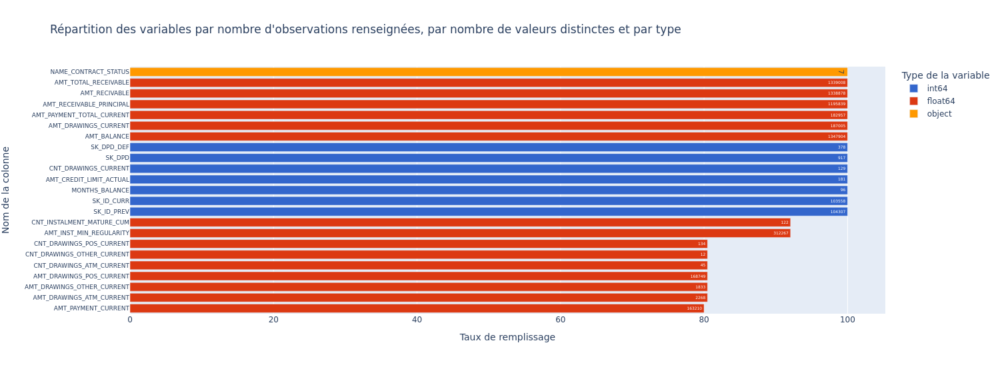

In [27]:
show_df_info_bar(df_credit_card_balance, width=1500)

In [28]:
df_info = get_df_info(df_credit_card_balance)
if "credit_card_balance" not in cols_to_remove:
    cols_to_remove["credit_card_balance"] = []
if df_info.loc[df_info["filled_ratio"]<filled_ratio_threshold, "column"].shape[0]>0:
    for c in df_info.loc[df_info["filled_ratio"]<filled_ratio_threshold, "column"]:
        cols_to_remove["credit_card_balance"].append(c)

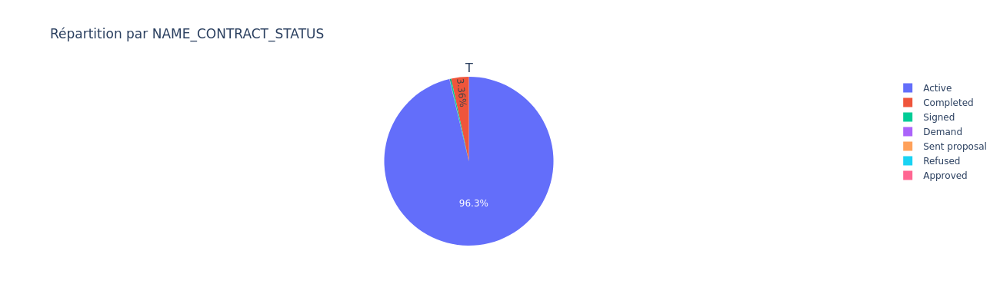

In [29]:
cat_cols = df_credit_card_balance.select_dtypes(include=[object]).columns
for y in range(1, len(cat_cols) + 1):
    fig = make_subplots(
        rows=1, 
        cols=1, 
        subplot_titles=("TOUS"),
        specs=[[{"type": "pie"}]]
    )


            
    
    vc = df_credit_card_balance.groupby(cat_cols[y-1]).count().reset_index()
    fig.append_trace(go.Pie(
        labels=vc.iloc[:,0], 
        values=vc.iloc[:,1],
        textposition='inside'
    ), row=1, col=1)

    
    fig.update_layout(height=400, width=1300, title_text=f"Répartition par {cat_cols[y-1]}")
    fig.show()

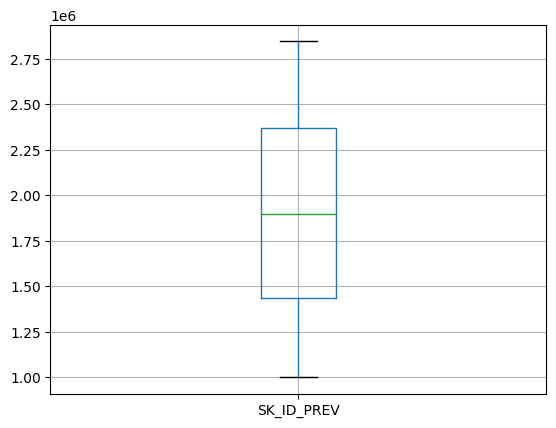

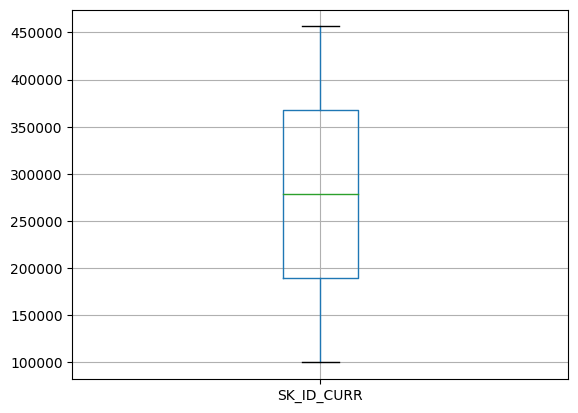

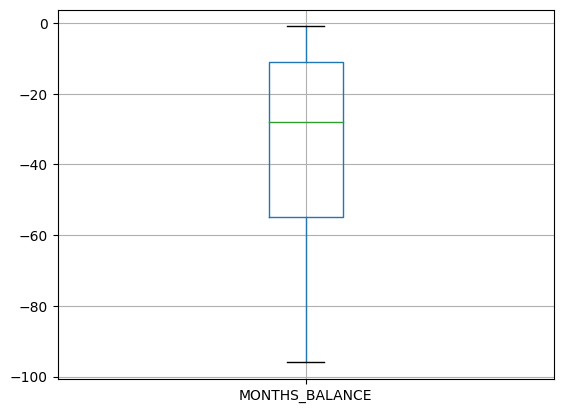

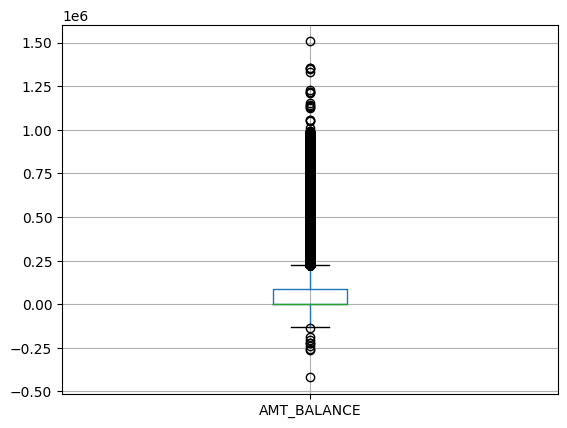

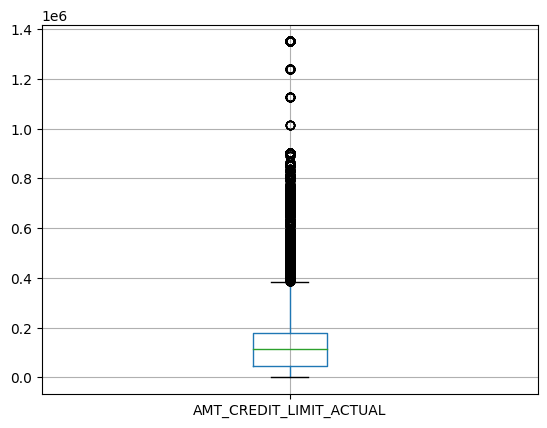

...

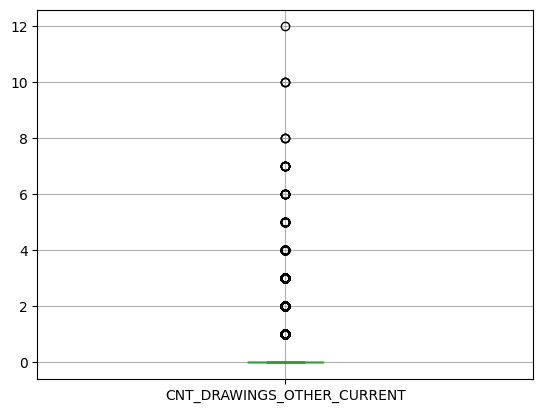

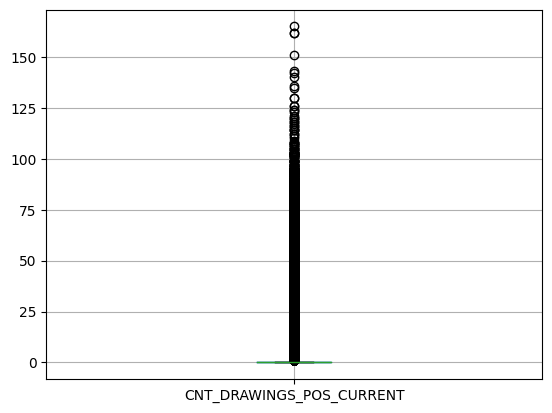

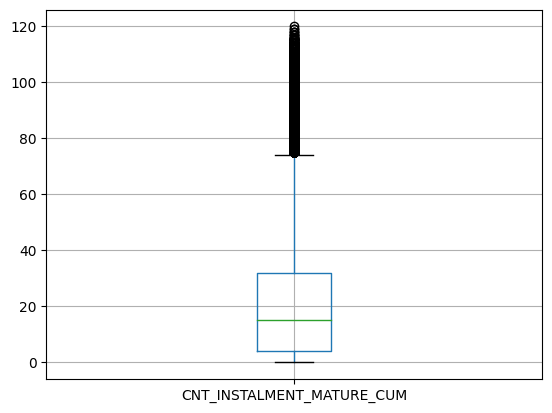

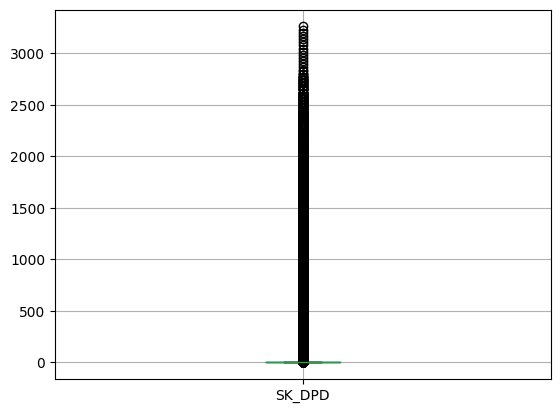

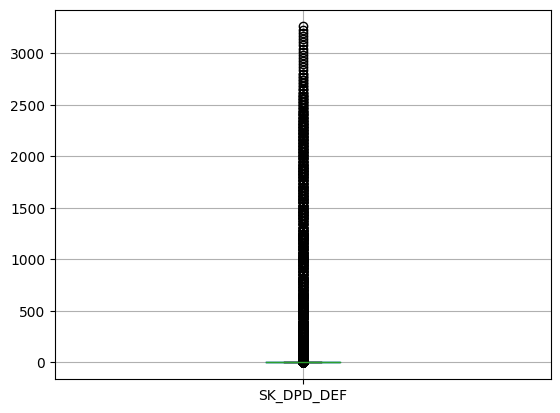

In [30]:
for col in list(df_credit_card_balance.select_dtypes(include=[int, float]).columns):
    df_credit_card_balance.boxplot(column=col) 
    plt.show()

In [31]:
cols_to_remove

{'bureau': ['AMT_CREDIT_MAX_OVERDUE', 'AMT_ANNUITY'],
 'credit_card_balance': []}

['AMT_DRAWINGS_CURRENT', 'AMT_PAYMENT_TOTAL_CURRENT', 'CNT_DRAWINGS_ATM_CURRENT', 'AMT_RECIVABLE', 'AMT_BALANCE', 'AMT_INST_MIN_REGULARITY', 'AMT_TOTAL_RECEIVABLE', 'AMT_RECEIVABLE_PRINCIPAL', 'AMT_DRAWINGS_ATM_CURRENT', 'AMT_PAYMENT_CURRENT']


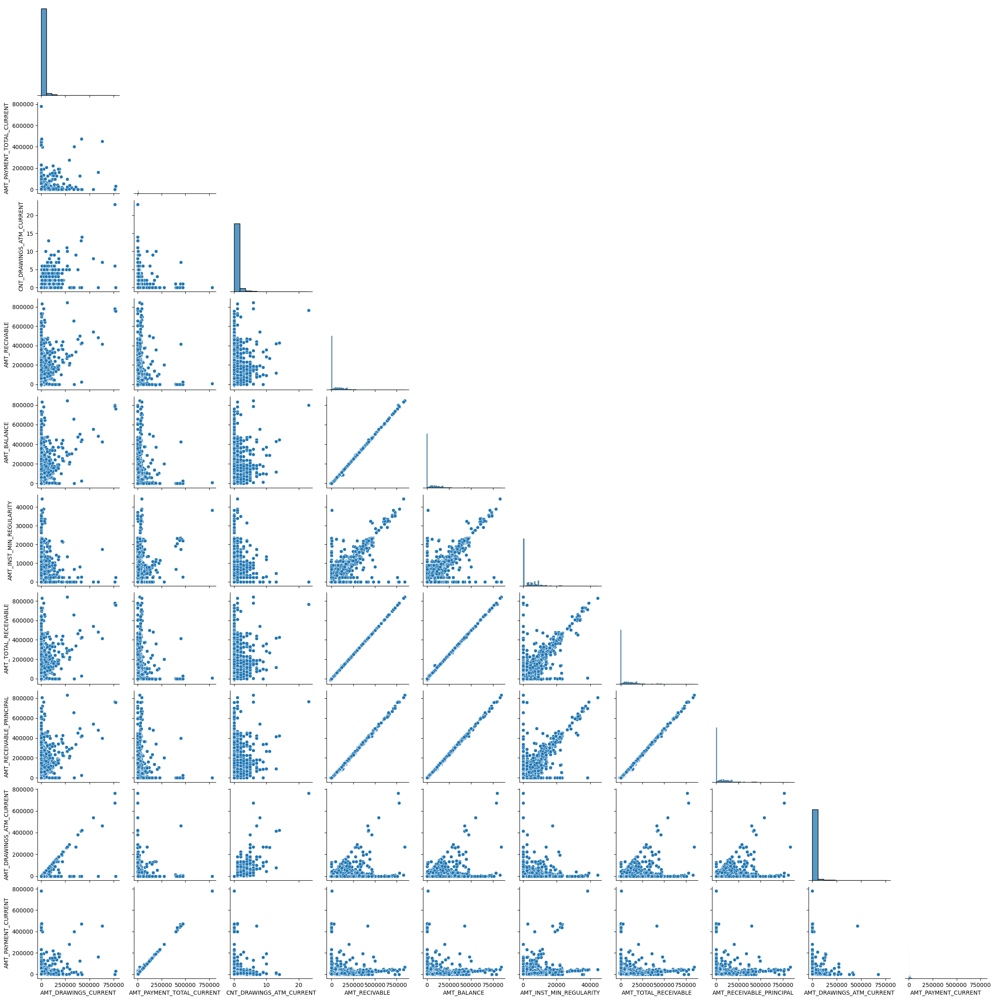

In [32]:

num_cols = [c for c in df_credit_card_balance.drop(columns=cols_to_remove["credit_card_balance"]).select_dtypes(include=np.float64).columns.tolist() if c not in ['SK_ID_CURR']]
df_credit_card_balance2 = df_credit_card_balance.drop(columns=cols_to_remove["credit_card_balance"]).dropna()
relations = []
for c in num_cols:
    df2 = df_credit_card_balance2.loc[:, [x for x in num_cols if x!=c]]
    r = r_regression(df2, df_credit_card_balance2[c])
    for i in range(0, len(r)):
        if r[i]>0.7:
            relations.append(c)
            relations.append(df2.columns[i])

relations = list(set(relations))

print(relations)

if len(relations)>0:
    sns.pairplot(
        df_credit_card_balance.sample(n=5000).loc[:, relations ],
        dropna=True,
        corner=True
    )
    plt.show()
else:
    print("pas de relation linéaire détectée")




Relations linéaires fortes 
- entre AMT_BALANCE et AMT_TOTAL_RECEIVABLE, AMT_RECEIVABLE_PRINCIPAL, AMT_RECIVABLE 
- et entre AMT_PAYMENT_CURRENT et AMT_PAYMENT_TOTAL_CURRENT

In [33]:
del df_credit_card_balance
gc.collect()

1037

# installments_payments

In [34]:
df_installments_payments = pd.read_csv("../assets/installments_payments.csv")
nb_total_features += df_installments_payments.shape[1]
df_installments_payments.head()


,SK_ID_PREV,SK_ID_CURR,NUM_INSTALMENT_VERSION,NUM_INSTALMENT_NUMBER,DAYS_INSTALMENT,DAYS_ENTRY_PAYMENT,AMT_INSTALMENT,AMT_PAYMENT
0,1054186,161674,1.0,6,-1180.0,-1187.0,6948.360,6948.360
1,1330831,151639,0.0,34,-2156.0,-2156.0,1716.525,1716.525
2,2085231,193053,2.0,1,-63.0,-63.0,25425.000,25425.000
3,2452527,199697,1.0,3,-2418.0,-2426.0,24350.130,24350.130
4,2714724,167756,1.0,2,-1383.0,-1366.0,2165.040,2160.585


In [35]:
df_installments_payments.info(verbose=True, show_counts=True)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 13605401 entries, 0 to 13605400
Data columns (total 8 columns):
 #   Column                  Non-Null Count     Dtype  
---  ------                  --------------     -----  
 0   SK_ID_PREV              13605401 non-null  int64  
 1   SK_ID_CURR              13605401 non-null  int64  
 2   NUM_INSTALMENT_VERSION  13605401 non-null  float64
 3   NUM_INSTALMENT_NUMBER   13605401 non-null  int64  
 4   DAYS_INSTALMENT         13605401 non-null  float64
 5   DAYS_ENTRY_PAYMENT      13602496 non-null  float64
 6   AMT_INSTALMENT          13605401 non-null  float64
 7   AMT_PAYMENT             13602496 non-null  float64
dtypes: float64(5), int64(3)
memory usage: 830.4 MB


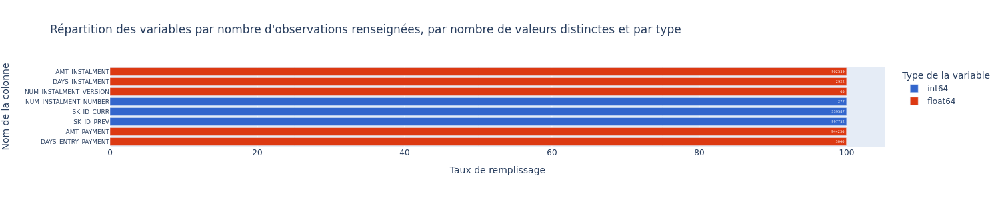

In [36]:
show_df_info_bar(df_installments_payments, width=1500)

In [37]:
df_info = get_df_info(df_installments_payments)
if "installments_payments" not in cols_to_remove:
    cols_to_remove["installments_payments"] = []
if df_info.loc[df_info["filled_ratio"]<filled_ratio_threshold, "column"].shape[0]>0:
    for c in df_info.loc[df_info["filled_ratio"]<filled_ratio_threshold, "column"]:
        cols_to_remove["installments_payments"].append(c)

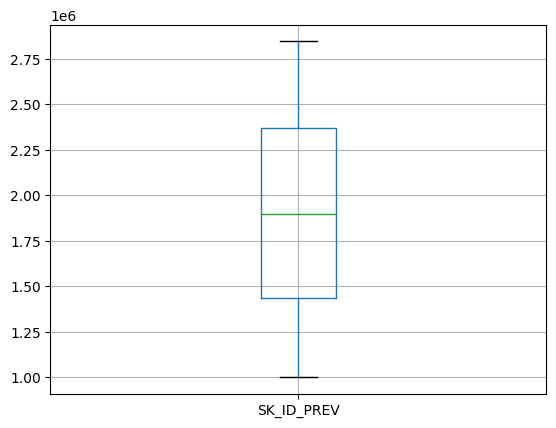

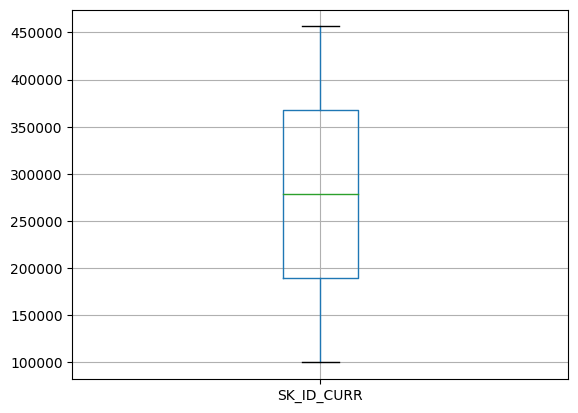

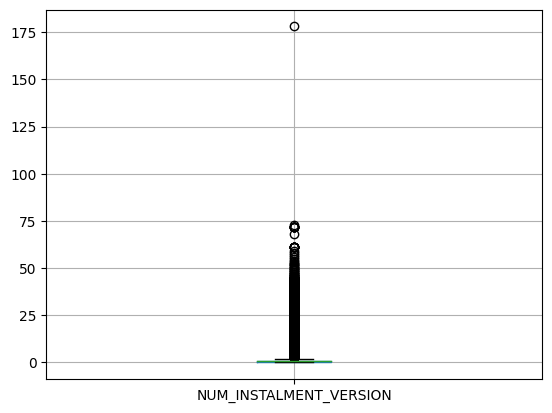

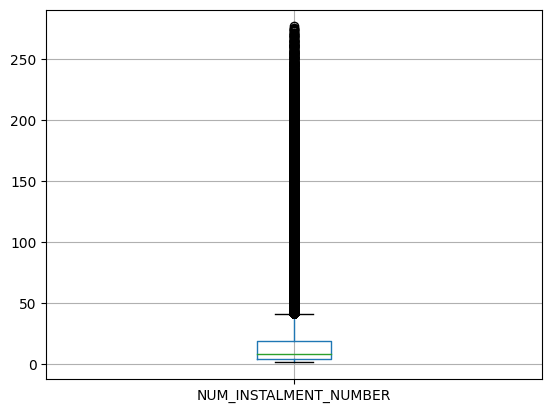

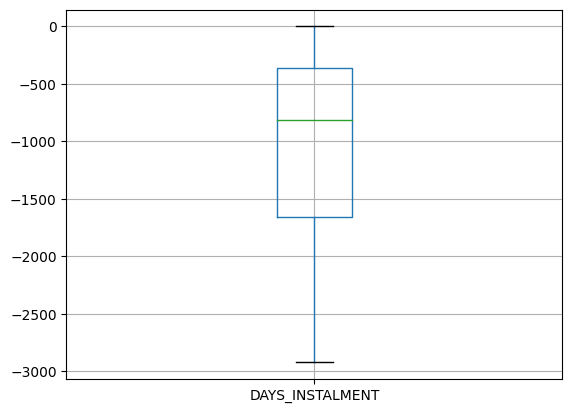

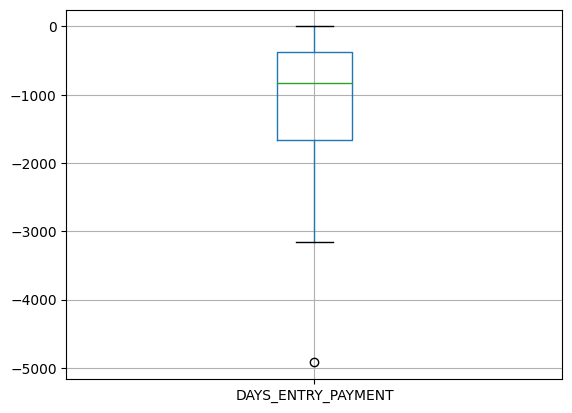

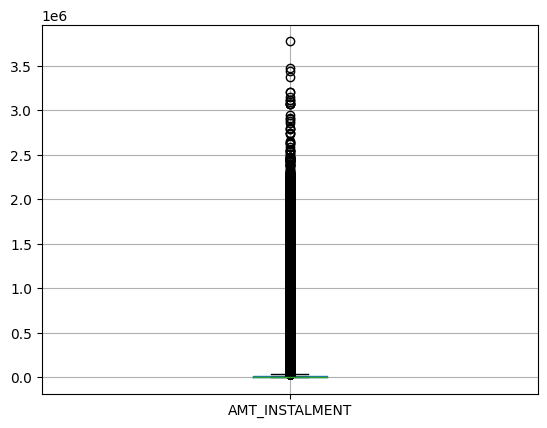

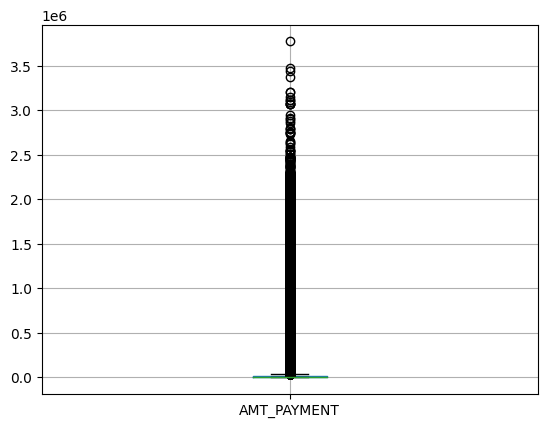

In [38]:
for col in list(df_installments_payments.select_dtypes(include=[int, float]).columns):
    df_installments_payments.boxplot(column=col) 
    plt.show()

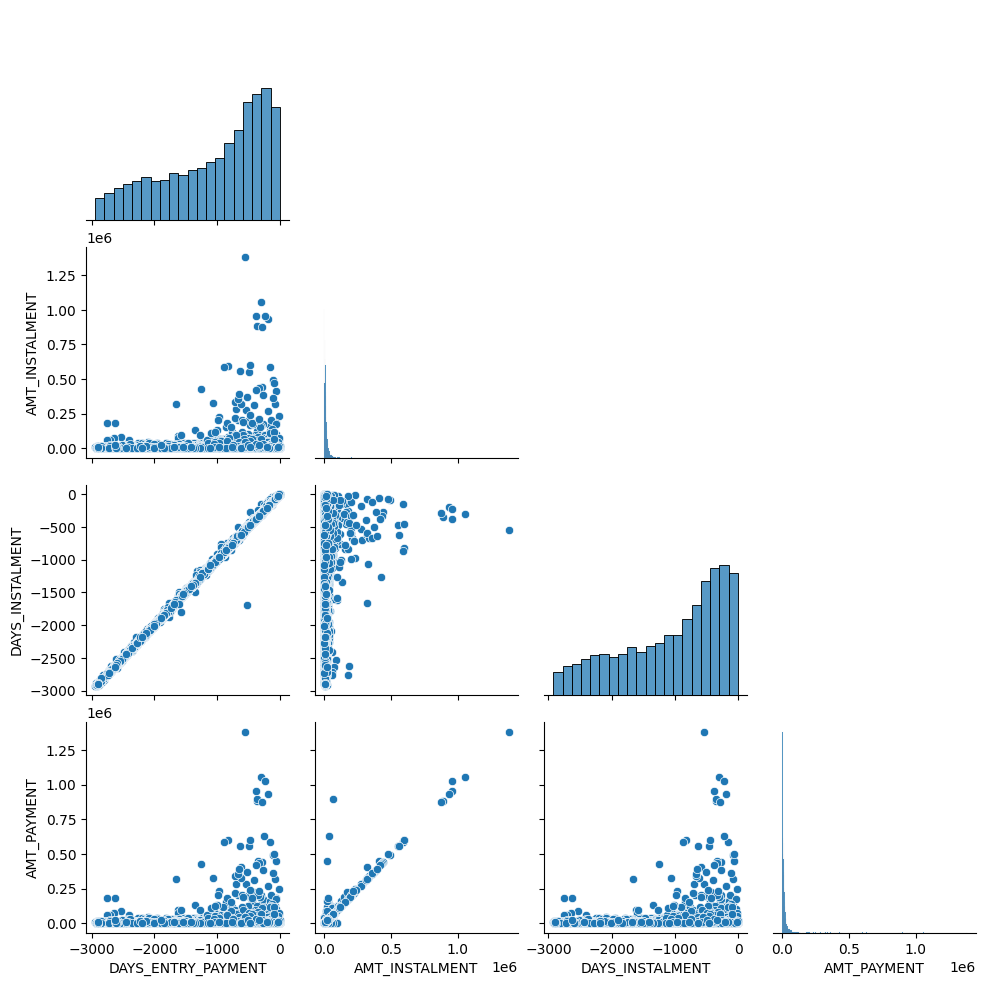

In [39]:
num_cols = [c for c in df_installments_payments.drop(columns=cols_to_remove["installments_payments"]).select_dtypes(include=np.float64).columns.tolist() if c not in ['SK_ID_CURR', 'SK_ID_PREV']]
df_installments_payments2 = df_installments_payments.drop(columns=cols_to_remove["installments_payments"]).dropna()
relations = []
for c in num_cols:
    df2 = df_installments_payments2.loc[:, [x for x in num_cols if x!=c]]
    r = r_regression(df2, df_installments_payments2[c])
    for i in range(0, len(r)):
        if r[i]>0.7:
            relations.append(c)
            relations.append(df2.columns[i])

relations = list(set(relations))


if len(relations)>0:
    sns.pairplot(
        df_installments_payments.sample(n=5000).loc[:, relations ].dropna(),
        dropna=True,
        corner=True
    )
    plt.show()
else:
    print("pas de relations linéaires détectées")


Relations fortes entre :
- DAYS_INSTALMENT et DAYS_ENTRY_PAYMENT
- AMT_INSTALMENT et AMT_PAYMENT

In [40]:
del df_installments_payments
gc.collect()

125

# POS_CASH_balance

In [41]:
df_pos_cash_balance = pd.read_csv("../assets/POS_CASH_balance.csv")
nb_total_features += df_pos_cash_balance.shape[1]
df_pos_cash_balance.head()


,SK_ID_PREV,SK_ID_CURR,MONTHS_BALANCE,CNT_INSTALMENT,CNT_INSTALMENT_FUTURE,NAME_CONTRACT_STATUS,SK_DPD,SK_DPD_DEF
0,1803195,182943,-31,48.0,45.0,Active,0,0
1,1715348,367990,-33,36.0,35.0,Active,0,0
2,1784872,397406,-32,12.0,9.0,Active,0,0
3,1903291,269225,-35,48.0,42.0,Active,0,0
4,2341044,334279,-35,36.0,35.0,Active,0,0


In [42]:
df_pos_cash_balance.info(verbose=True, show_counts=True)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10001358 entries, 0 to 10001357
Data columns (total 8 columns):
 #   Column                 Non-Null Count     Dtype  
---  ------                 --------------     -----  
 0   SK_ID_PREV             10001358 non-null  int64  
 1   SK_ID_CURR             10001358 non-null  int64  
 2   MONTHS_BALANCE         10001358 non-null  int64  
 3   CNT_INSTALMENT         9975287 non-null   float64
 4   CNT_INSTALMENT_FUTURE  9975271 non-null   float64
 5   NAME_CONTRACT_STATUS   10001358 non-null  object 
 6   SK_DPD                 10001358 non-null  int64  
 7   SK_DPD_DEF             10001358 non-null  int64  
dtypes: float64(2), int64(5), object(1)
memory usage: 610.4+ MB


In [43]:
df_pos_cash_balance.describe()

,SK_ID_PREV,SK_ID_CURR,MONTHS_BALANCE,CNT_INSTALMENT,CNT_INSTALMENT_FUTURE,SK_DPD,SK_DPD_DEF
count,1.000136e+07,1.000136e+07,1.000136e+07,9.975287e+06,9.975271e+06,1.000136e+07,1.000136e+07
mean,1.903217e+06,2.784039e+05,-3.501259e+01,1.708965e+01,1.048384e+01,1.160693e+01,6.544684e-01
std,5.358465e+05,1.027637e+05,2.606657e+01,1.199506e+01,1.110906e+01,1.327140e+02,3.276249e+01
min,1.000001e+06,1.000010e+05,-9.600000e+01,1.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
25%,1.434405e+06,1.895500e+05,-5.400000e+01,1.000000e+01,3.000000e+00,0.000000e+00,0.000000e+00
50%,1.896565e+06,2.786540e+05,-2.800000e+01,1.200000e+01,7.000000e+00,0.000000e+00,0.000000e+00
75%,2.368963e+06,3.674290e+05,-1.300000e+01,2.400000e+01,1.400000e+01,0.000000e+00,0.000000e+00
max,2.843499e+06,4.562550e+05,-1.000000e+00,9.200000e+01,8.500000e+01,4.231000e+03,3.595000e+03


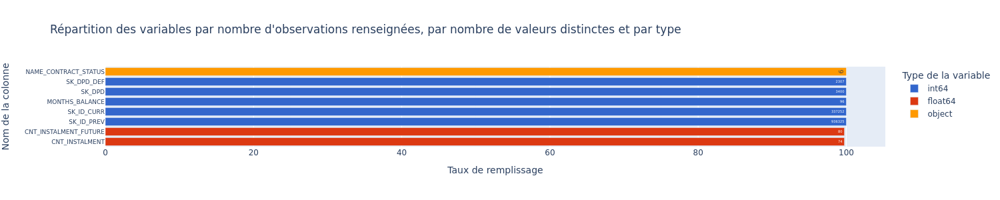

In [44]:
show_df_info_bar(df_pos_cash_balance, width=1500)

In [45]:
df_info = get_df_info(df_pos_cash_balance)
if "pos_cash_balance" not in cols_to_remove:
    cols_to_remove["pos_cash_balance"] = []
if df_info.loc[df_info["filled_ratio"]<filled_ratio_threshold, "column"].shape[0]>0:
    for c in df_info.loc[df_info["filled_ratio"]<filled_ratio_threshold, "column"]:
        cols_to_remove["pos_cash_balance"].append(c)

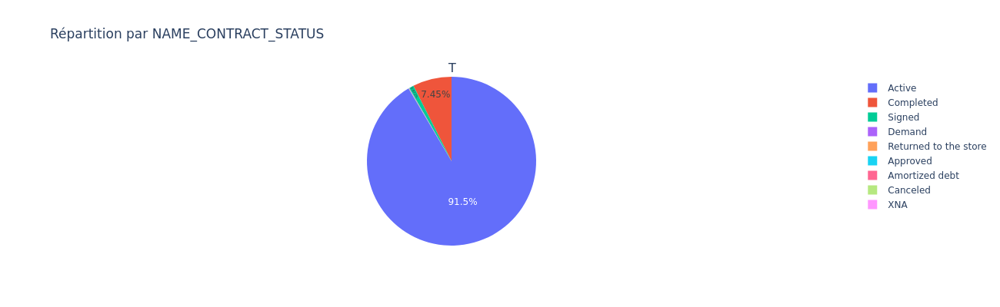

In [46]:
cat_cols = df_pos_cash_balance.select_dtypes(include=[object]).columns
for y in range(1, len(cat_cols) + 1):
    fig = make_subplots(
        rows=1, 
        cols=1, 
        subplot_titles=("TOUS"),
        specs=[[{"type": "pie"}]]
    )


            
    
    vc = df_pos_cash_balance.groupby(cat_cols[y-1]).count().reset_index()
    fig.append_trace(go.Pie(
        labels=vc.iloc[:,0], 
        values=vc.iloc[:,1],
        textposition='inside'
    ), row=1, col=1)

    
    fig.update_layout(height=400, width=1300, title_text=f"Répartition par {cat_cols[y-1]}")
    fig.show()

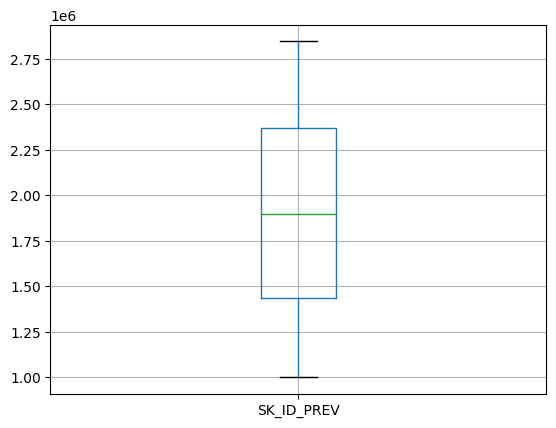

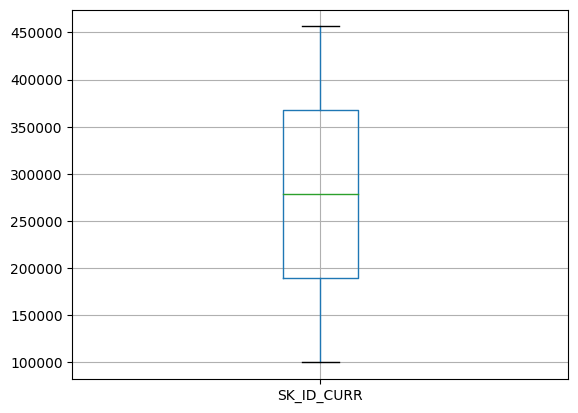

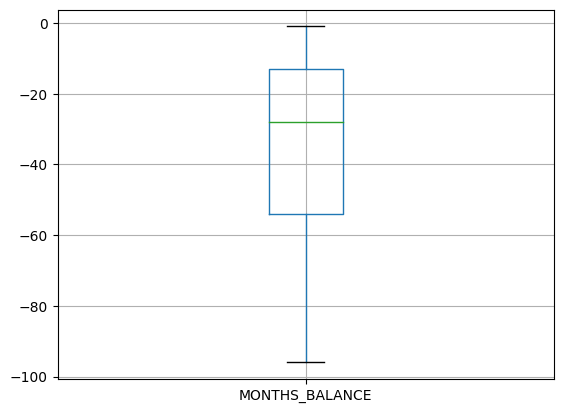

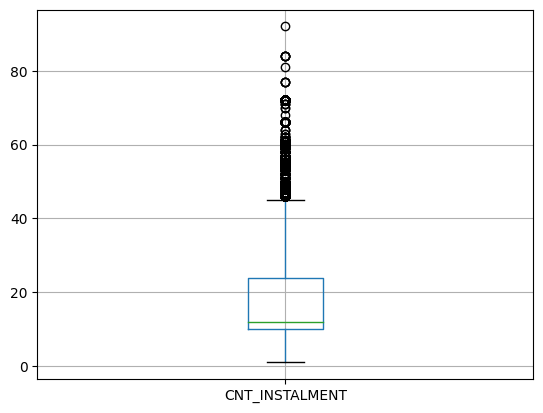

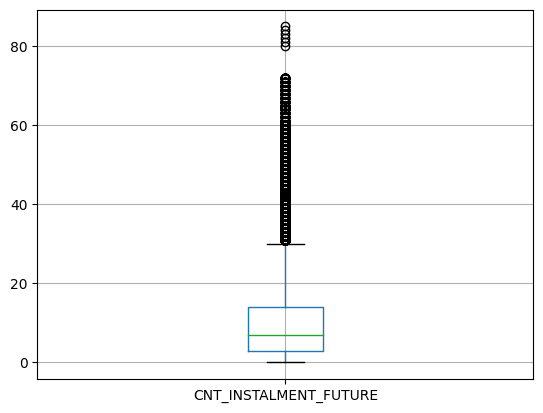

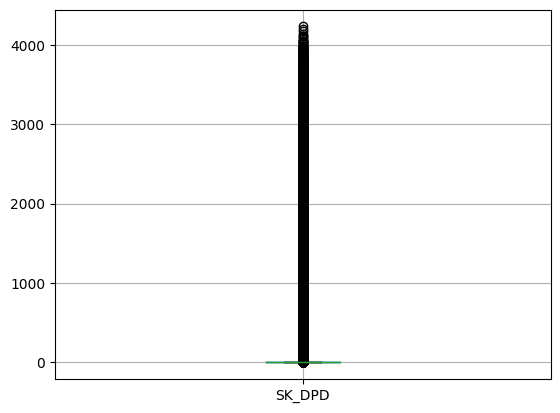

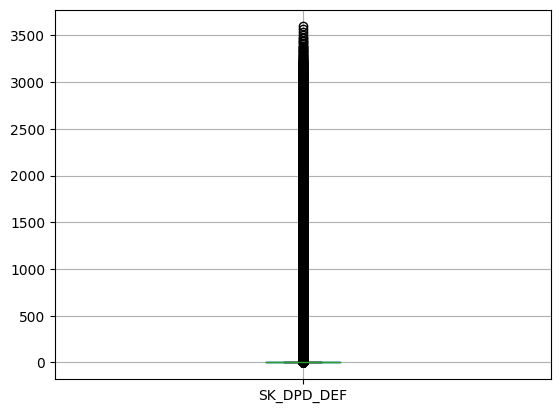

In [47]:
for col in list(df_pos_cash_balance.select_dtypes(include=[int, float]).columns):
    df_pos_cash_balance.boxplot(column=col) 
    plt.show()

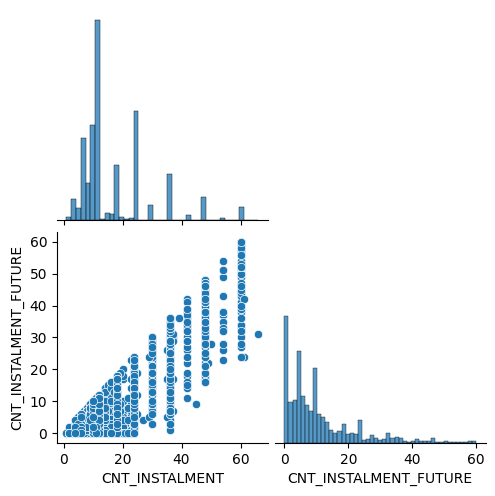

In [48]:
num_cols = [c for c in df_pos_cash_balance.drop(columns=cols_to_remove["pos_cash_balance"]).select_dtypes(include=np.float64).columns.tolist() if c not in ['SK_ID_CURR', 'SK_ID_PREV']]
df_pos_cash_balance2 = df_pos_cash_balance.drop(columns=cols_to_remove["pos_cash_balance"]).dropna()
relations = []
for c in num_cols:
    df2 = df_pos_cash_balance2.loc[:, [x for x in num_cols if x!=c]]
    r = r_regression(df2, df_pos_cash_balance2[c])
    for i in range(0, len(r)):
        if r[i]>0.7:
            relations.append(c)
            relations.append(df2.columns[i])

relations = list(set(relations))


if len(relations)>0:
    sns.pairplot(
        df_pos_cash_balance.sample(n=5000).loc[:, relations ].dropna(),
        dropna=True,
        corner=True
    )
    plt.show()
else:
    print("pas de relations linéaires détectées")


In [49]:
del df_pos_cash_balance
gc.collect()

170777

# previous_applications

In [72]:
df_previous_application = pd.read_csv("../assets/previous_application.csv")
nb_total_features += df_previous_application.shape[1]
df_previous_application.head()


,SK_ID_PREV,SK_ID_CURR,NAME_CONTRACT_TYPE,AMT_ANNUITY,AMT_APPLICATION,AMT_CREDIT,AMT_DOWN_PAYMENT,AMT_GOODS_PRICE,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,FLAG_LAST_APPL_PER_CONTRACT,NFLAG_LAST_APPL_IN_DAY,RATE_DOWN_PAYMENT,RATE_INTEREST_PRIMARY,RATE_INTEREST_PRIVILEGED,NAME_CASH_LOAN_PURPOSE,NAME_CONTRACT_STATUS,DAYS_DECISION,NAME_PAYMENT_TYPE,CODE_REJECT_REASON,NAME_TYPE_SUITE,NAME_CLIENT_TYPE,NAME_GOODS_CATEGORY,NAME_PORTFOLIO,NAME_PRODUCT_TYPE,CHANNEL_TYPE,SELLERPLACE_AREA,NAME_SELLER_INDUSTRY,CNT_PAYMENT,NAME_YIELD_GROUP,PRODUCT_COMBINATION,DAYS_FIRST_DRAWING,DAYS_FIRST_DUE,DAYS_LAST_DUE_1ST_VERSION,DAYS_LAST_DUE,DAYS_TERMINATION,NFLAG_INSURED_ON_APPROVAL
0,2030495,271877,Consumer loans,1730.430,17145.0,17145.0,0.0,17145.0,SATURDAY,15,Y,1,0.0,0.182832,0.867336,XAP,Approved,-73,Cash through the bank,XAP,NaN,Repeater,Mobile,POS,XNA,Country-wide,35,Connectivity,12.0,middle,POS mobile with interest,365243.0,-42.0,300.0,-42.0,-37.0,0.0
1,2802425,108129,Cash loans,25188.615,607500.0,679671.0,NaN,607500.0,THURSDAY,11,Y,1,NaN,NaN,NaN,XNA,Approved,-164,XNA,XAP,Unaccompanied,Repeater,XNA,Cash,x-sell,Contact center,-1,XNA,36.0,low_action,Cash X-Sell: low,365243.0,-134.0,916.0,365243.0,365243.0,1.0
2,2523466,122040,Cash loans,15060.735,112500.0,136444.5,NaN,112500.0,TUESDAY,11,Y,1,NaN,NaN,NaN,XNA,Approved,-301,Cash through the bank,XAP,"Spouse, partner",Repeater,XNA,Cash,x-sell,Credit and cash offices,-1,XNA,12.0,high,Cash X-Sell: high,365243.0,-271.0,59.0,365243.0,365243.0,1.0
3,2819243,176158,Cash loans,47041.335,450000.0,470790.0,NaN,450000.0,MONDAY,7,Y,1,NaN,NaN,NaN,XNA,Approved,-512,Cash through the bank,XAP,NaN,Repeater,XNA,Cash,x-sell,Credit and cash offices,-1,XNA,12.0,middle,Cash X-Sell: middle,365243.0,-482.0,-152.0,-182.0,-177.0,1.0
4,1784265,202054,Cash loans,31924.395,337500.0,404055.0,NaN,337500.0,THURSDAY,9,Y,1,NaN,NaN,NaN,Repairs,Refused,-781,Cash through the bank,HC,NaN,Repeater,XNA,Cash,walk-in,Credit and cash offices,-1,XNA,24.0,high,Cash Street: high,NaN,NaN,NaN,NaN,NaN,NaN


In [51]:
df_previous_application.info(verbose=True, show_counts=True)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1670214 entries, 0 to 1670213
Data columns (total 37 columns):
 #   Column                       Non-Null Count    Dtype  
---  ------                       --------------    -----  
 0   SK_ID_PREV                   1670214 non-null  int64  
 1   SK_ID_CURR                   1670214 non-null  int64  
 2   NAME_CONTRACT_TYPE           1670214 non-null  object 
 3   AMT_ANNUITY                  1297979 non-null  float64
 4   AMT_APPLICATION              1670214 non-null  float64
 5   AMT_CREDIT                   1670213 non-null  float64
 6   AMT_DOWN_PAYMENT             774370 non-null   float64
 7   AMT_GOODS_PRICE              1284699 non-null  float64
 8   WEEKDAY_APPR_PROCESS_START   1670214 non-null  object 
 9   HOUR_APPR_PROCESS_START      1670214 non-null  int64  
 10  FLAG_LAST_APPL_PER_CONTRACT  1670214 non-null  object 
 11  NFLAG_LAST_APPL_IN_DAY       1670214 non-null  int64  
 12  RATE_DOWN_PAYMENT            774370 non-nu

In [52]:
df_previous_application.describe()

,SK_ID_PREV,SK_ID_CURR,AMT_ANNUITY,AMT_APPLICATION,AMT_CREDIT,AMT_DOWN_PAYMENT,AMT_GOODS_PRICE,HOUR_APPR_PROCESS_START,NFLAG_LAST_APPL_IN_DAY,RATE_DOWN_PAYMENT,RATE_INTEREST_PRIMARY,RATE_INTEREST_PRIVILEGED,DAYS_DECISION,SELLERPLACE_AREA,CNT_PAYMENT,DAYS_FIRST_DRAWING,DAYS_FIRST_DUE,DAYS_LAST_DUE_1ST_VERSION,DAYS_LAST_DUE,DAYS_TERMINATION,NFLAG_INSURED_ON_APPROVAL
count,1.670214e+06,1.670214e+06,1.297979e+06,1.670214e+06,1.670213e+06,7.743700e+05,1.284699e+06,1.670214e+06,1.670214e+06,774370.000000,5951.000000,5951.000000,1.670214e+06,1.670214e+06,1.297984e+06,997149.000000,997149.000000,997149.000000,997149.000000,997149.000000,997149.000000
mean,1.923089e+06,2.783572e+05,1.595512e+04,1.752339e+05,1.961140e+05,6.697402e+03,2.278473e+05,1.248418e+01,9.964675e-01,0.079637,0.188357,0.773503,-8.806797e+02,3.139511e+02,1.605408e+01,342209.855039,13826.269337,33767.774054,76582.403064,81992.343838,0.332570
std,5.325980e+05,1.028148e+05,1.478214e+04,2.927798e+05,3.185746e+05,2.092150e+04,3.153966e+05,3.334028e+00,5.932963e-02,0.107823,0.087671,0.100879,7.790997e+02,7.127443e+03,1.456729e+01,88916.115833,72444.869708,106857.034789,149647.415123,153303.516729,0.471134
min,1.000001e+06,1.000010e+05,0.000000e+00,0.000000e+00,0.000000e+00,-9.000000e-01,0.000000e+00,0.000000e+00,0.000000e+00,-0.000015,0.034781,0.373150,-2.922000e+03,-1.000000e+00,0.000000e+00,-2922.000000,-2892.000000,-2801.000000,-2889.000000,-2874.000000,0.000000
25%,1.461857e+06,1.893290e+05,6.321780e+03,1.872000e+04,2.416050e+04,0.000000e+00,5.084100e+04,1.000000e+01,1.000000e+00,0.000000,0.160716,0.715645,-1.300000e+03,-1.000000e+00,6.000000e+00,365243.000000,-1628.000000,-1242.000000,-1314.000000,-1270.000000,0.000000
50%,1.923110e+06,2.787145e+05,1.125000e+04,7.104600e+04,8.054100e+04,1.638000e+03,1.123200e+05,1.200000e+01,1.000000e+00,0.051605,0.189122,0.835095,-5.810000e+02,3.000000e+00,1.200000e+01,365243.000000,-831.000000,-361.000000,-537.000000,-499.000000,0.000000
75%,2.384280e+06,3.675140e+05,2.065842e+04,1.803600e+05,2.164185e+05,7.740000e+03,2.340000e+05,1.500000e+01,1.000000e+00,0.108909,0.193330,0.852537,-2.800000e+02,8.200000e+01,2.400000e+01,365243.000000,-411.000000,129.000000,-74.000000,-44.000000,1.000000
max,2.845382e+06,4.562550e+05,4.180581e+05,6.905160e+06,6.905160e+06,3.060045e+06,6.905160e+06,2.300000e+01,1.000000e+00,1.000000,1.000000,1.000000,-1.000000e+00,4.000000e+06,8.400000e+01,365243.000000,365243.000000,365243.000000,365243.000000,365243.000000,1.000000


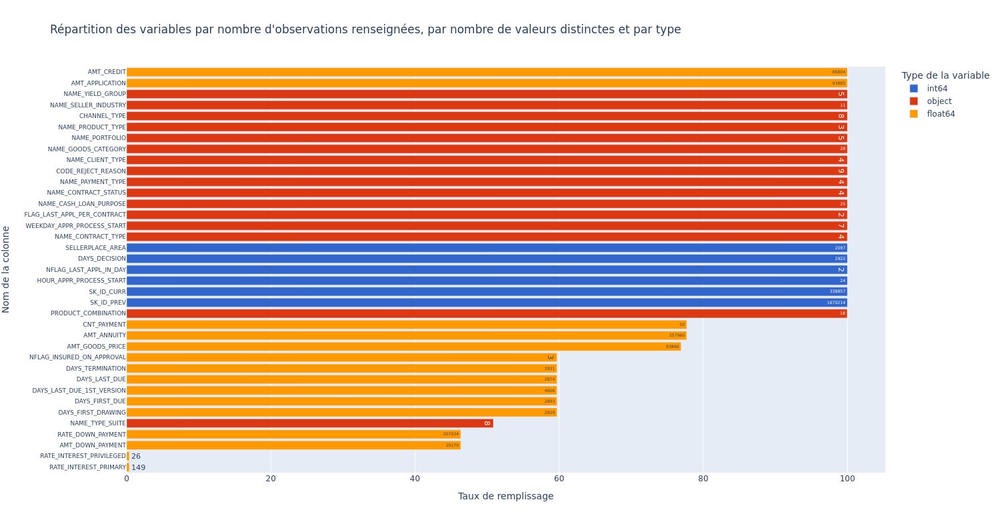

In [53]:
show_df_info_bar(df_previous_application, width=1500)

In [73]:
df_info = get_df_info(df_previous_application)
cols_to_remove["previous_application"] = []
if df_info.loc[df_info["filled_ratio"]<filled_ratio_threshold, "column"].shape[0]>0:
    for c in df_info.loc[df_info["filled_ratio"]<filled_ratio_threshold, "column"]:
        cols_to_remove["previous_application"].append(c)

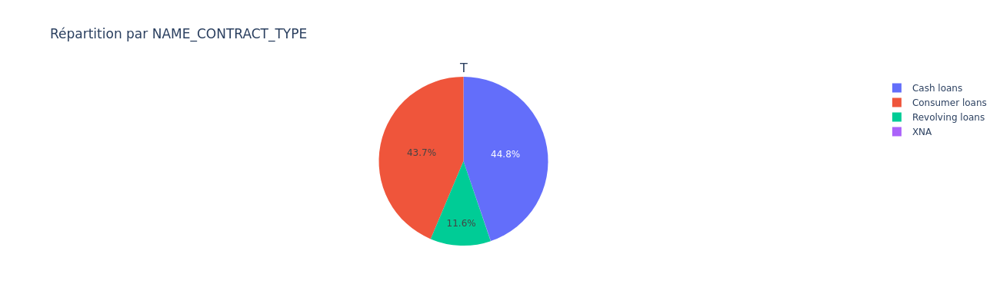

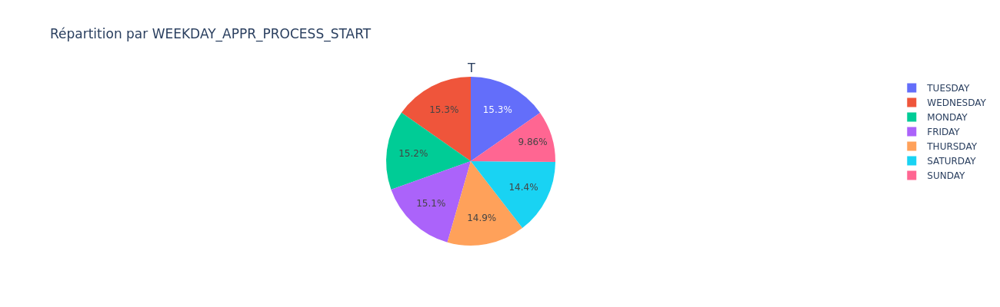

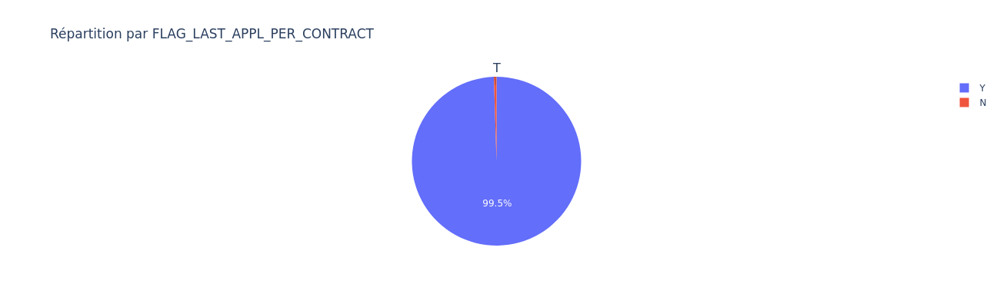

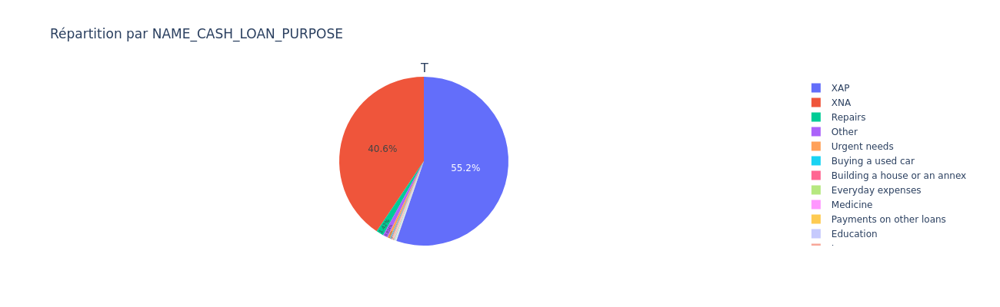

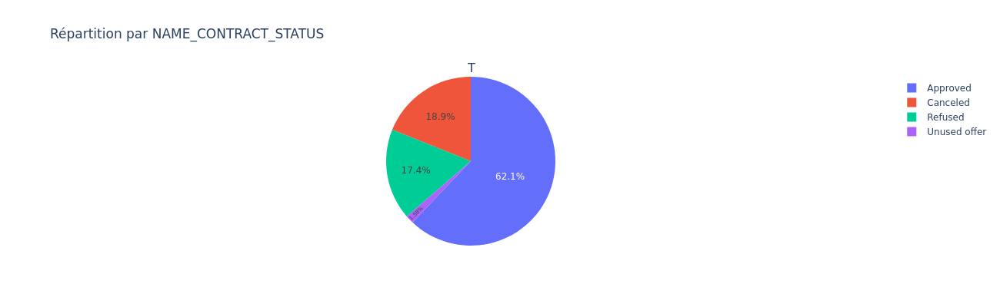

...

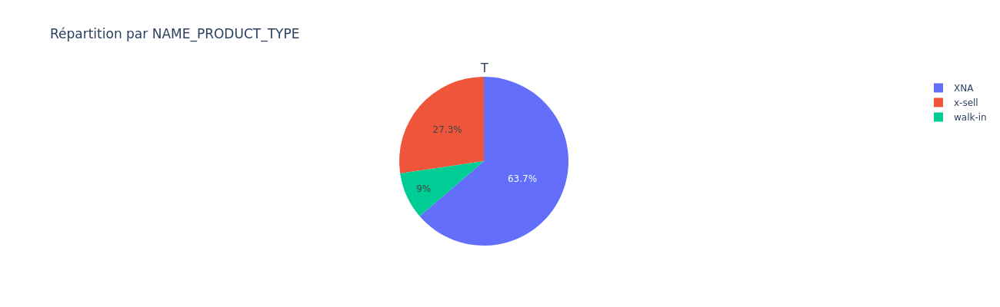

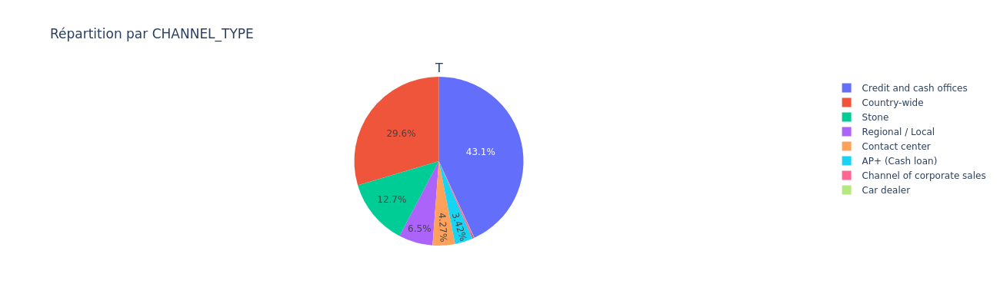

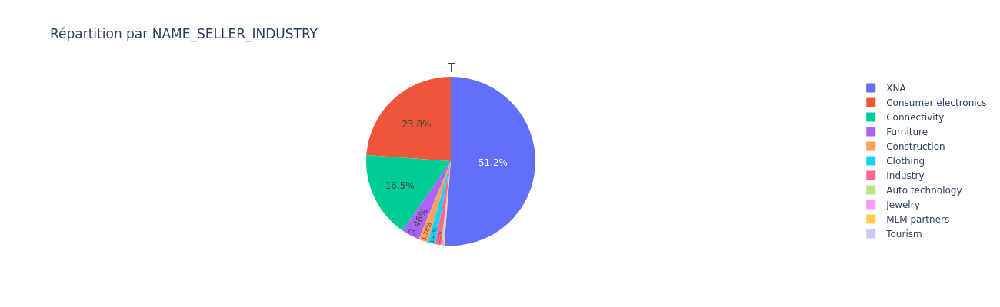

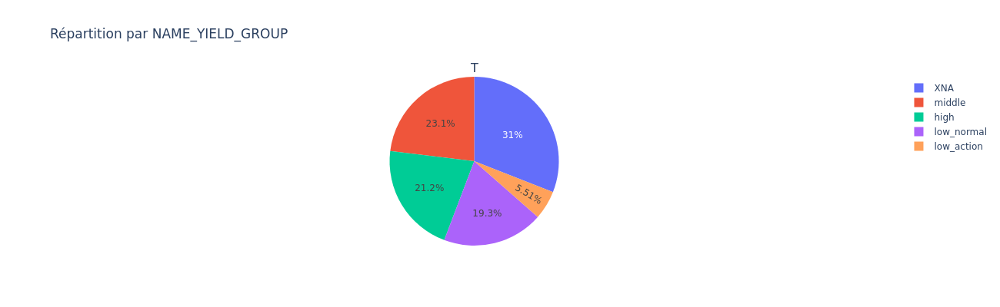

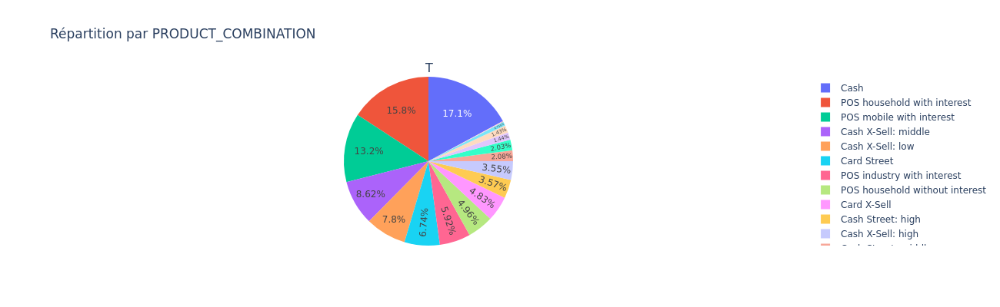

In [55]:
cat_cols = df_previous_application.select_dtypes(include=[object]).columns
for y in range(1, len(cat_cols) + 1):
    fig = make_subplots(
        rows=1, 
        cols=1, 
        subplot_titles=("TOUS"),
        specs=[[{"type": "pie"}]]
    )


            
    
    vc = df_previous_application.groupby(cat_cols[y-1]).count().reset_index()
    fig.append_trace(go.Pie(
        labels=vc.iloc[:,0], 
        values=vc.iloc[:,1],
        textposition='inside'
    ), row=1, col=1)

    
    fig.update_layout(height=400, width=1300, title_text=f"Répartition par {cat_cols[y-1]}")
    fig.show()

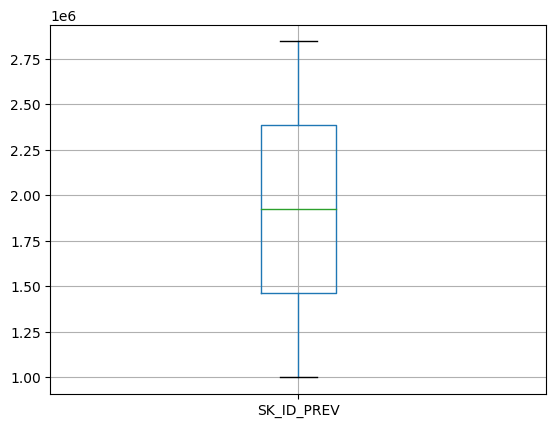

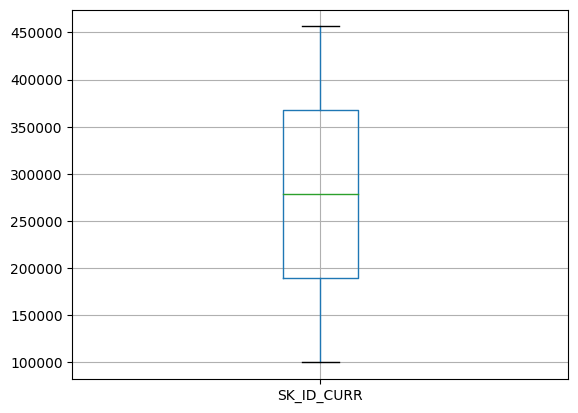

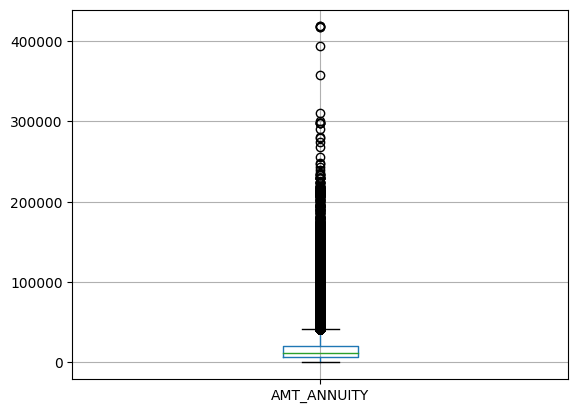

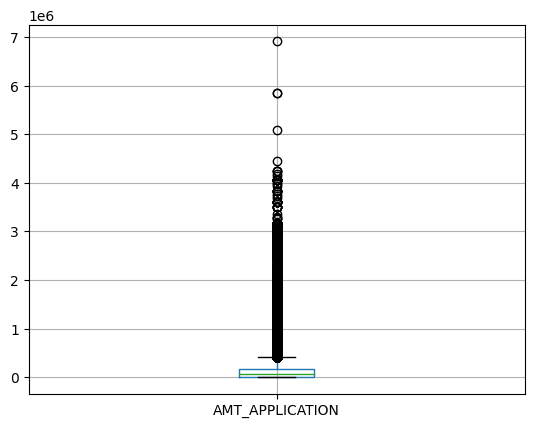

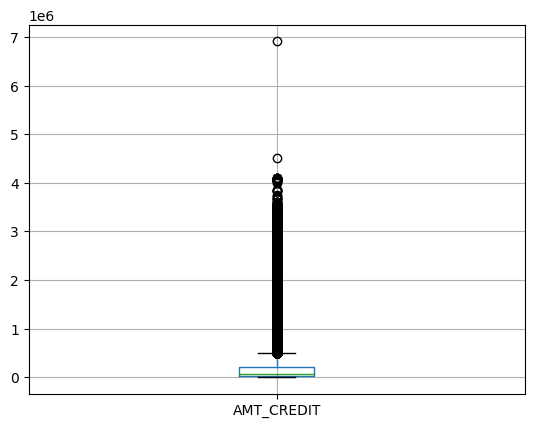

...

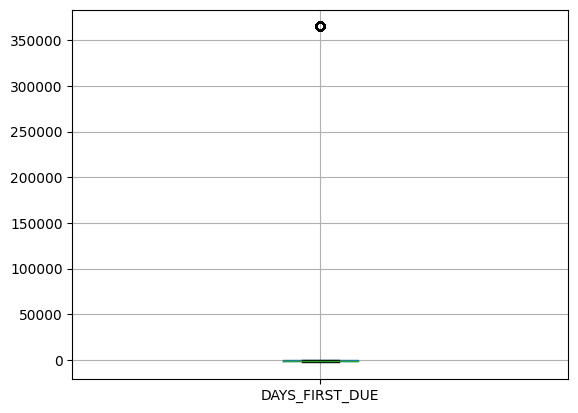

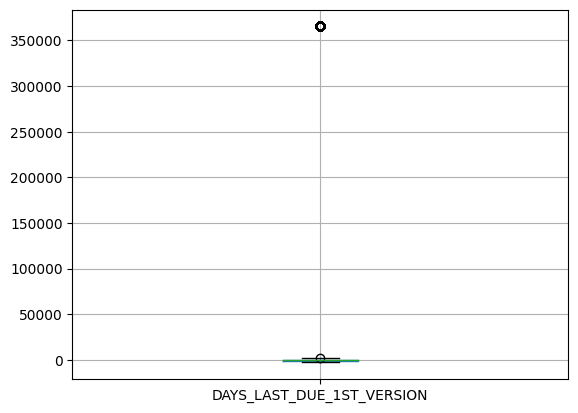

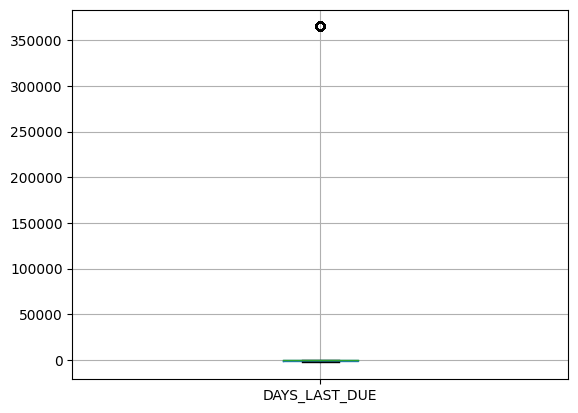

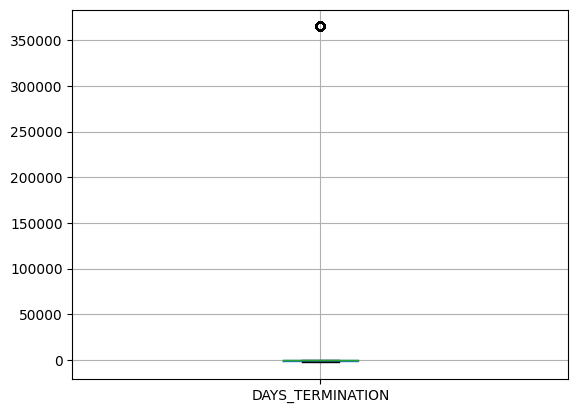

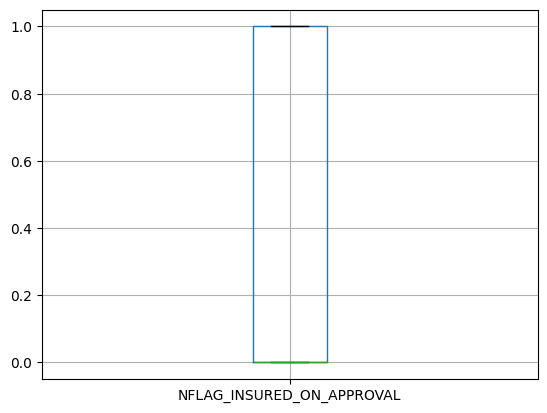

In [56]:
for col in list(df_previous_application.select_dtypes(include=[int, float]).columns):
    df_previous_application.boxplot(column=col) 
    plt.show()

On constate que les features DAYS_FIRST_DRAWING, DAYS_FIRST_DUE, DAYS_LAST_DUE_1ST_VERSION, DAYS_LAST_DUE, DAYS_TERMINATION ont des valeurs au delà de 35000 (soit 95 ans). Nous devons les corriger

In [74]:
for c in ["DAYS_FIRST_DRAWING", "DAYS_FIRST_DUE", "DAYS_LAST_DUE_1ST_VERSION", "DAYS_LAST_DUE", "DAYS_TERMINATION"]:
    df_previous_application.loc[df_previous_application[c]>20000, c] = np.floor(df_previous_application[c] / 100)

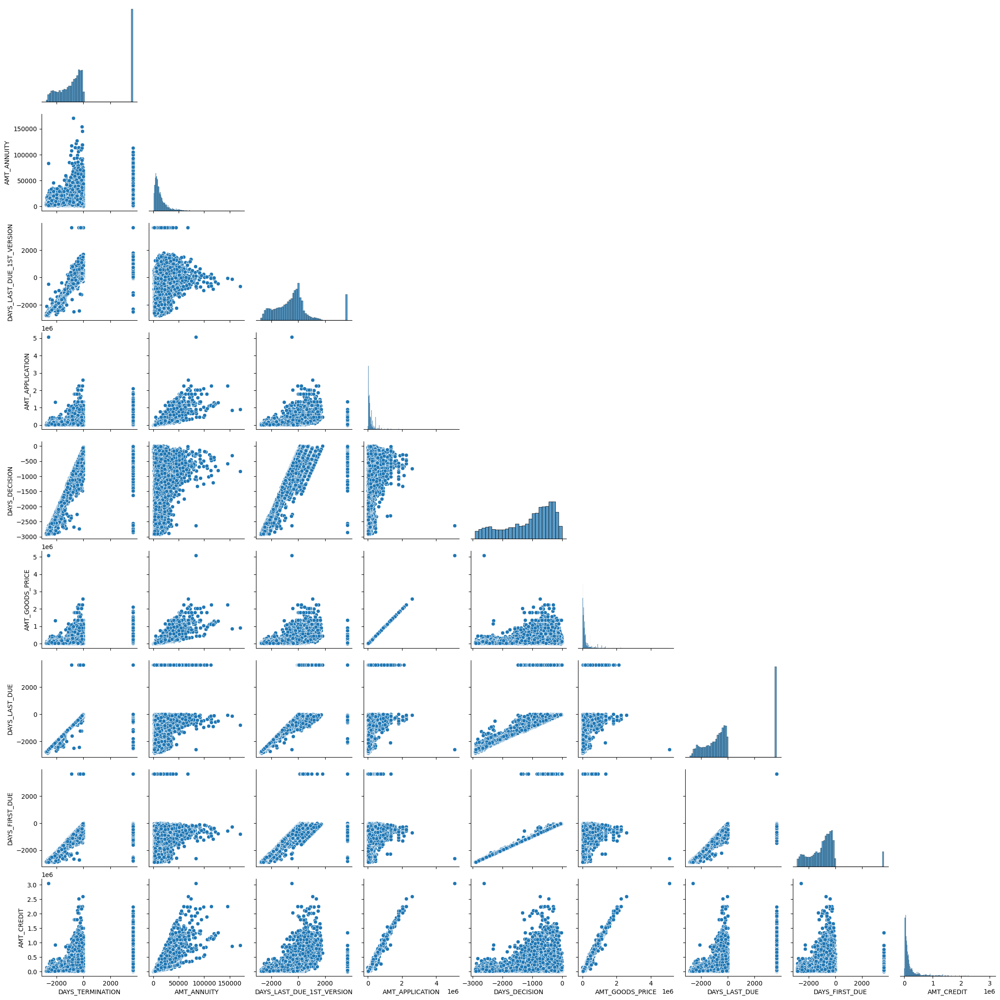

In [80]:

num_cols = [c for c in df_previous_application.drop(columns=cols_to_remove["previous_application"]).select_dtypes(include=[np.number]).columns.tolist() if c not in ['SK_ID_CURR', 'SK_ID_PREV']]
df_previous_application2 = df_previous_application.drop(columns=cols_to_remove["previous_application"]).dropna()
relations = []
for c in num_cols:
    df2 = df_previous_application2.loc[:, [x for x in num_cols if x!=c]]
    
    r = r_regression(df2, df_previous_application2[c])
    for i in range(0, len(r)):
        if r[i]>0.7:
            relations.append(c)
            relations.append(df2.columns[i])

relations = list(set(relations))

if len(relations)>0:
    sns.pairplot(
        df_previous_application.sample(n=15000).loc[:, relations ].dropna(),
        dropna=True,
        corner=True
    )
    plt.show()
else:
    print("pas de relation linéaire détectée")

Forte relation linéaire entre AMT_CREDIT, AMT_APPLICATION et AMT_GOODS_PRICE ainsi qu'entre DAYS_DECISION et DAYS_FIRST_DUE

In [81]:
del df_previous_application
gc.collect()

515041

# application_train

In [82]:
df_application = pd.read_csv("../assets/application_train.csv")
nb_total_features += df_application.shape[1]

In [83]:
df_application.head()

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,NAME_TYPE_SUITE,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OWN_CAR_AGE,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,ORGANIZATION_TYPE,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,APARTMENTS_AVG,BASEMENTAREA_AVG,YEARS_BEGINEXPLUATATION_AVG,YEARS_BUILD_AVG,COMMONAREA_AVG,ELEVATORS_AVG,ENTRANCES_AVG,FLOORSMAX_AVG,FLOORSMIN_AVG,LANDAREA_AVG,LIVINGAPARTMENTS_AVG,LIVINGAREA_AVG,NONLIVINGAPARTMENTS_AVG,NONLIVINGAREA_AVG,APARTMENTS_MODE,BASEMENTAREA_MODE,YEARS_BEGINEXPLUATATION_MODE,YEARS_BUILD_MODE,COMMONAREA_MODE,ELEVATORS_MODE,ENTRANCES_MODE,FLOORSMAX_MODE,FLOORSMIN_MODE,LANDAREA_MODE,LIVINGAPARTMENTS_MODE,LIVINGAREA_MODE,NONLIVINGAPARTMENTS_MODE,NONLIVINGAREA_MODE,APARTMENTS_MEDI,BASEMENTAREA_MEDI,YEARS_BEGINEXPLUATATION_MEDI,YEARS_BUILD_MEDI,COMMONAREA_MEDI,ELEVATORS_MEDI,ENTRANCES_MEDI,FLOORSMAX_MEDI,FLOORSMIN_MEDI,LANDAREA_MEDI,LIVINGAPARTMENTS_MEDI,LIVINGAREA_MEDI,NONLIVINGAPARTMENTS_MEDI,NONLIVINGAREA_MEDI,FONDKAPREMONT_MODE,HOUSETYPE_MODE,TOTALAREA_MODE,WALLSMATERIAL_MODE,EMERGENCYSTATE_MODE,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
0,100002,1,Cash loans,M,N,Y,0,202500.0,406597.5,24700.5,351000.0,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,0.018801,-9461,-637,-3648.0,-2120,NaN,1,1,0,1,1,0,Laborers,1.0,2,2,WEDNESDAY,10,0,0,0,0,0,0,Business Entity Type 3,0.083037,0.262949,0.139376,0.0247,0.0369,0.9722,0.6192,0.0143,0.00,0.0690,0.0833,0.1250,0.0369,0.0202,0.0190,0.0000,0.0000,0.0252,0.0383,0.9722,0.6341,0.0144,0.0000,0.0690,0.0833,0.1250,0.0377,0.022,0.0198,0.0,0.0,0.0250,0.0369,0.9722,0.6243,0.0144,0.00,0.0690,0.0833,0.1250,0.0375,0.0205,0.0193,0.0000,0.00,reg oper account,block of flats,0.0149,"Stone, brick",No,2.0,2.0,2.0,2.0,-1134.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,1.0
1,100003,0,Cash loans,F,N,N,0,270000.0,1293502.5,35698.5,1129500.0,Family,State servant,Higher education,Married,House / apartment,0.003541,-16765,-1188,-1186.0,-291,NaN,1,1,0,1,1,0,Core staff,2.0,1,1,MONDAY,11,0,0,0,0,0,0,School,0.311267,0.622246,NaN,0.0959,0.0529,0.9851,0.7960,0.0605,0.08,0.0345,0.2917,0.3333,0.0130,0.0773,0.0549,0.0039,0.0098,0.0924,0.0538,0.9851,0.8040,0.0497,0.0806,0.0345,0.2917,0.3333,0.0128,0.079,0.0554,0.0,0.0,0.0968,0.0529,0.9851,0.7987,0.0608,0.08,0.0345,0.2917,0.3333,0.0132,0.0787,0.0558,0.0039,0.01,reg oper account,block of flats,0.0714,Block,No,1.0,0.0,1.0,0.0,-828.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0
2,100004,0,Revolving loans,M,Y,Y,0,67500.0,135000.0,6750.0,135000.0,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,0.010032,-19046,-225,-4260.0,-2531,26.0,1,1,1,1,1,0,Laborers,1.0,2,2,MONDAY,9,0,0,0,0,0,0,Government,NaN,0.555912,0.729567,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,

In [84]:
df_application.info(verbose=True, show_counts=True)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 307511 entries, 0 to 307510
Data columns (total 122 columns):
 #    Column                        Non-Null Count   Dtype  
---   ------                        --------------   -----  
 0    SK_ID_CURR                    307511 non-null  int64  
 1    TARGET                        307511 non-null  int64  
 2    NAME_CONTRACT_TYPE            307511 non-null  object 
 3    CODE_GENDER                   307511 non-null  object 
 4    FLAG_OWN_CAR                  307511 non-null  object 
 5    FLAG_OWN_REALTY               307511 non-null  object 
 6    CNT_CHILDREN                  307511 non-null  int64  
 7    AMT_INCOME_TOTAL              307511 non-null  float64
 8    AMT_CREDIT                    307511 non-null  float64
 9    AMT_ANNUITY                   307499 non-null  float64
 10   AMT_GOODS_PRICE               307233 non-null  float64
 11   NAME_TYPE_SUITE               306219 non-null  object 
 12   NAME_INCOME_TYPE            

In [85]:
df_application.describe()

,SK_ID_CURR,TARGET,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OWN_CAR_AGE,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,APARTMENTS_AVG,BASEMENTAREA_AVG,YEARS_BEGINEXPLUATATION_AVG,YEARS_BUILD_AVG,COMMONAREA_AVG,ELEVATORS_AVG,ENTRANCES_AVG,FLOORSMAX_AVG,FLOORSMIN_AVG,LANDAREA_AVG,LIVINGAPARTMENTS_AVG,LIVINGAREA_AVG,NONLIVINGAPARTMENTS_AVG,NONLIVINGAREA_AVG,APARTMENTS_MODE,BASEMENTAREA_MODE,YEARS_BEGINEXPLUATATION_MODE,YEARS_BUILD_MODE,COMMONAREA_MODE,ELEVATORS_MODE,ENTRANCES_MODE,FLOORSMAX_MODE,FLOORSMIN_MODE,LANDAREA_MODE,LIVINGAPARTMENTS_MODE,LIVINGAREA_MODE,NONLIVINGAPARTMENTS_MODE,NONLIVINGAREA_MODE,APARTMENTS_MEDI,BASEMENTAREA_MEDI,YEARS_BEGINEXPLUATATION_MEDI,YEARS_BUILD_MEDI,COMMONAREA_MEDI,ELEVATORS_MEDI,ENTRANCES_MEDI,FLOORSMAX_MEDI,FLOORSMIN_MEDI,LANDAREA_MEDI,LIVINGAPARTMENTS_MEDI,LIVINGAREA_MEDI,NONLIVINGAPARTMENTS_MEDI,NONLIVINGAREA_MEDI,TOTALAREA_MODE,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
count,307511.000000,307511.000000,307511.000000,3.075110e+05,3.075110e+05,307499.000000,3.072330e+05,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,104582.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307509.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,134133.000000,3.068510e+05,246546.000000,151450.00000,127568.000000,157504.000000,103023.000000,92646.000000,143620.000000,152683.000000,154491.000000,98869.000000,124921.000000,97312.000000,153161.000000,93997.000000,137829.000000,151450.000000,127568.000000,157504.000000,103023.000000,92646.000000,143620.000000,152683.000000,154491.000000,98869.000000,124921.000000,97312.000000,153161.000000,93997.000000,137829.000000,151450.000000,127568.000000,157504.000000,103023.000000,92646.000000,143620.000000,152683.000000,154491.000000,98869.000000,124921.000000,97312.000000,153161.000000,93997.000000,137829.000000,159080.000000,306490.000000,306490.000000,306490.000000,306490.000000,307510.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.00000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,265992.000000,265992.000000,265992.000000,265992.000000,265992.000000,265992.000000
mean,278180.518577,0.080729,0.417052,1.687979e+05,5.990260e+05,27108.573909,5.383962e+05,0.020868,-16036.995067,63815.045904,-4986.120328,-2994.202373,12.061091,0.999997,0.819889,0.199368,0.998133,0.281066,0.056720,2.152665,2.052463,2.031521,12.063419,0.015144,0.050769,0.040659,0.078173,0.230454,0.179555,0.502130,5.143927e-01,0.510853,0.11744,0.088442,0.977735,0.752471,0.044621,0.078942,0.149725,0.226282,0.231894,0.066333,0.100775,0.107399,0.008809,0.028358,0.114231,0.087543,0.977065,0.759637,0.042553,0.074490,0.145193,0.222315,0.228058,0.064958,0.105645,0.105975,0.008076,0.027022,0.117850,0.087955,0.97

Nous allons étudier les différentes répartitions des features catégorielles, aussi en fonction de la variable target

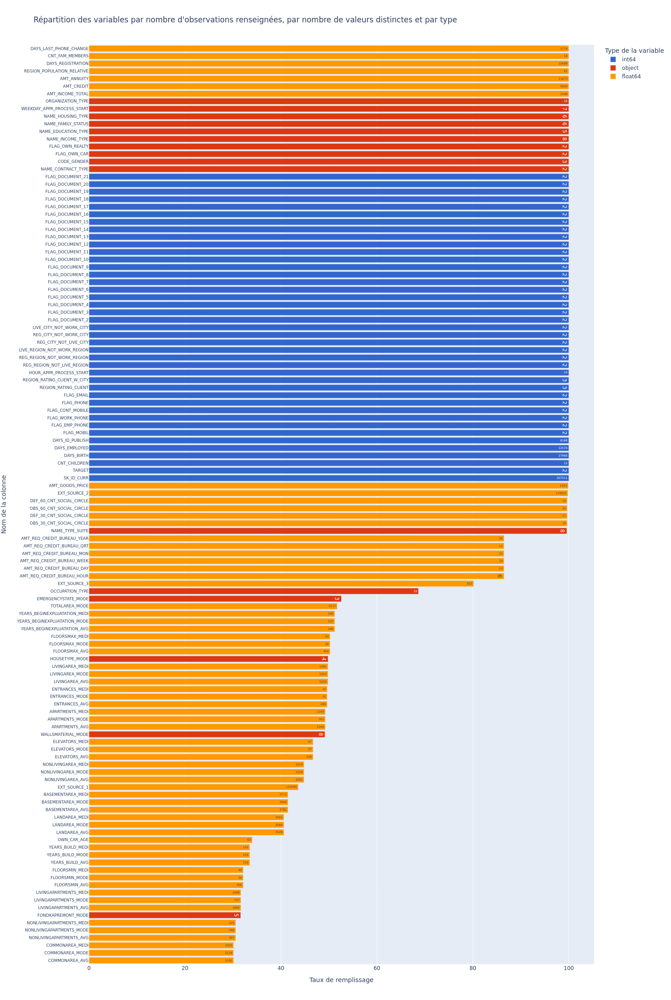

In [86]:
show_df_info_bar(df_application, width=1500)

In [87]:
df_info = get_df_info(df_application)
if "application_train" not in cols_to_remove:
    cols_to_remove["application_train"] = []
if df_info.loc[df_info["filled_ratio"]<filled_ratio_threshold, "column"].shape[0]>0:
    for c in df_info.loc[df_info["filled_ratio"]<filled_ratio_threshold, "column"]:
        cols_to_remove["application_train"].append(c)

In [88]:
df_application.groupby("TARGET").size().reset_index(name="nb")

,TARGET,nb
0,0,282686
1,1,24825


In [89]:
df_application.loc[df_application["EXT_SOURCE_3"].isna() & ~df_application["EXT_SOURCE_2"].isna()].head()

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,NAME_TYPE_SUITE,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OWN_CAR_AGE,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,ORGANIZATION_TYPE,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,APARTMENTS_AVG,BASEMENTAREA_AVG,YEARS_BEGINEXPLUATATION_AVG,YEARS_BUILD_AVG,COMMONAREA_AVG,ELEVATORS_AVG,ENTRANCES_AVG,FLOORSMAX_AVG,FLOORSMIN_AVG,LANDAREA_AVG,LIVINGAPARTMENTS_AVG,LIVINGAREA_AVG,NONLIVINGAPARTMENTS_AVG,NONLIVINGAREA_AVG,APARTMENTS_MODE,BASEMENTAREA_MODE,YEARS_BEGINEXPLUATATION_MODE,YEARS_BUILD_MODE,COMMONAREA_MODE,ELEVATORS_MODE,ENTRANCES_MODE,FLOORSMAX_MODE,FLOORSMIN_MODE,LANDAREA_MODE,LIVINGAPARTMENTS_MODE,LIVINGAREA_MODE,NONLIVINGAPARTMENTS_MODE,NONLIVINGAREA_MODE,APARTMENTS_MEDI,BASEMENTAREA_MEDI,YEARS_BEGINEXPLUATATION_MEDI,YEARS_BUILD_MEDI,COMMONAREA_MEDI,ELEVATORS_MEDI,ENTRANCES_MEDI,FLOORSMAX_MEDI,FLOORSMIN_MEDI,LANDAREA_MEDI,LIVINGAPARTMENTS_MEDI,LIVINGAREA_MEDI,NONLIVINGAPARTMENTS_MEDI,NONLIVINGAREA_MEDI,FONDKAPREMONT_MODE,HOUSETYPE_MODE,TOTALAREA_MODE,WALLSMATERIAL_MODE,EMERGENCYSTATE_MODE,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
1,100003,0,Cash loans,F,N,N,0,270000.0,1293502.5,35698.5,1129500.0,Family,State servant,Higher education,Married,House / apartment,0.003541,-16765,-1188,-1186.0,-291,NaN,1,1,0,1,1,0,Core staff,2.0,1,1,MONDAY,11,0,0,0,0,0,0,School,0.311267,0.622246,NaN,0.0959,0.0529,0.9851,0.7960,0.0605,0.08,0.0345,0.2917,0.3333,0.0130,0.0773,0.0549,0.0039,0.0098,0.0924,0.0538,0.9851,0.8040,0.0497,0.0806,0.0345,0.2917,0.3333,0.0128,0.0790,0.0554,0.0000,0.000,0.0968,0.0529,0.9851,0.7987,0.0608,0.08,0.0345,0.2917,0.3333,0.0132,0.0787,0.0558,0.0039,0.0100,reg oper account,block of flats,0.0714,Block,No,1.0,0.0,1.0,0.0,-828.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0
3,100006,0,Cash loans,F,N,Y,0,135000.0,312682.5,29686.5,297000.0,Unaccompanied,Working,Secondary / secondary special,Civil marriage,House / apartment,0.008019,-19005,-3039,-9833.0,-2437,NaN,1,1,0,1,0,0,Laborers,2.0,2,2,WEDNESDAY,17,0,0,0,0,0,0,Business Entity Type 3,NaN,0.650442,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2.0,0.0,2.0,0.0,-617.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN
4,100007,0,Cash loans,M,N,Y,0,121500.0,513000.0,21865.5,513000.0,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,0.028663,-19932,-3038,-4311.0,-3458,NaN,1,1,0,1,0,0,Core staff,1.0,2,2,THURSDAY,11,0,0,0,0,1,1,Religion,NaN,0.322738,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,0.0,0.0,-1106.0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0
9,100012,0

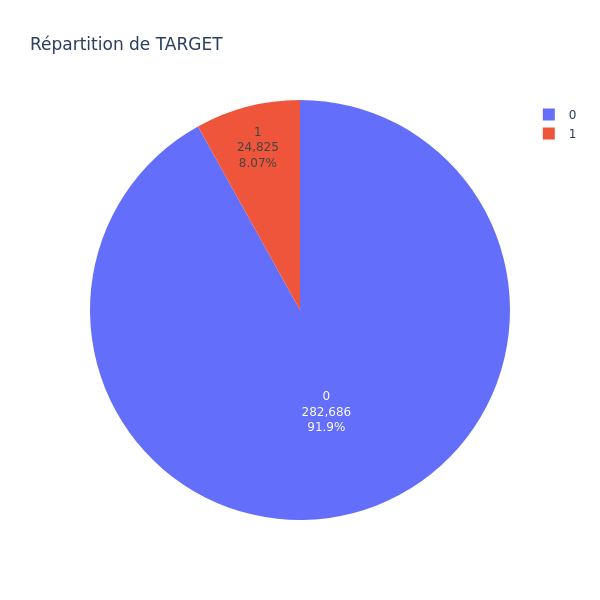

In [90]:
fig = px.pie(df_application.groupby("TARGET").size().reset_index(name="nb"), values="nb", names="TARGET", title="Répartition de TARGET")
fig.update_traces(textposition='inside', textinfo='percent+label+value')
fig.update_layout(width=600, height=600)
fig.show()

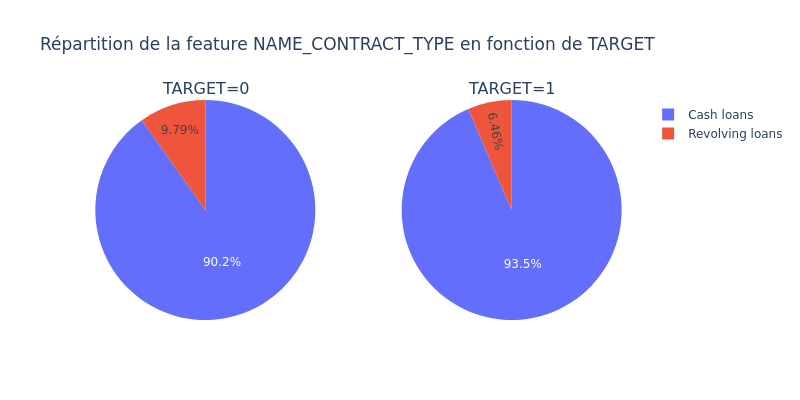

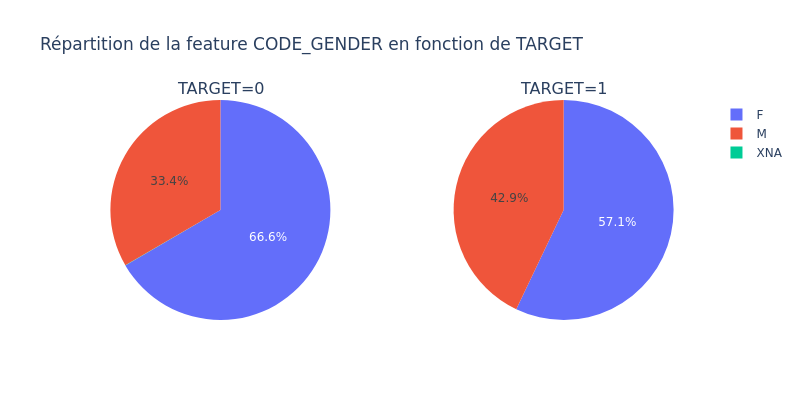

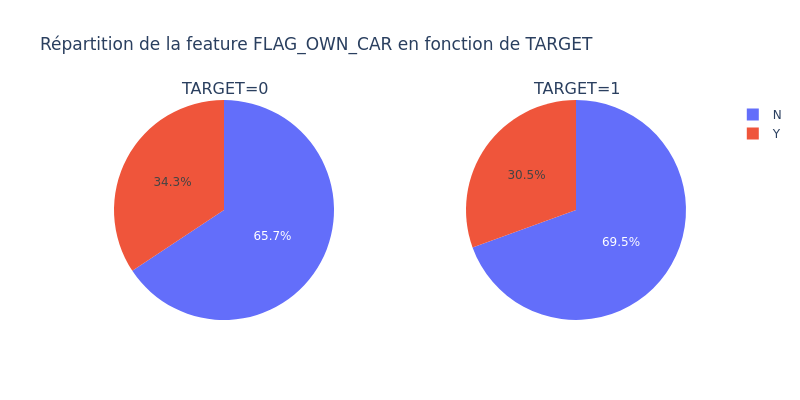

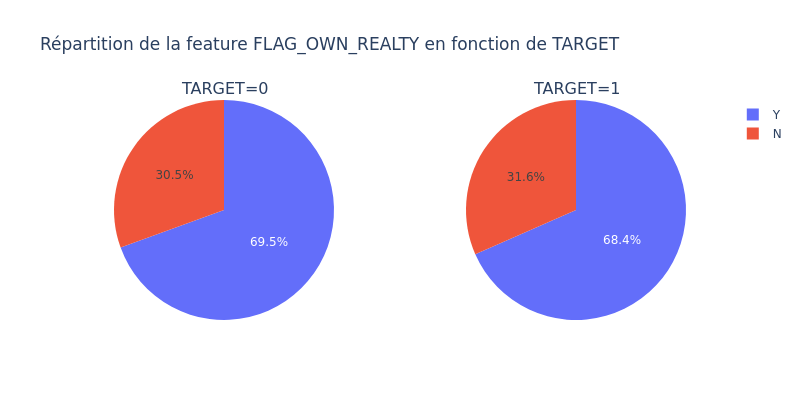

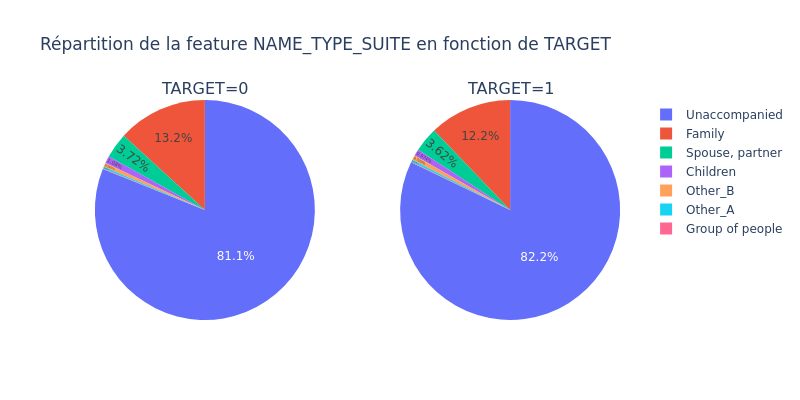

...

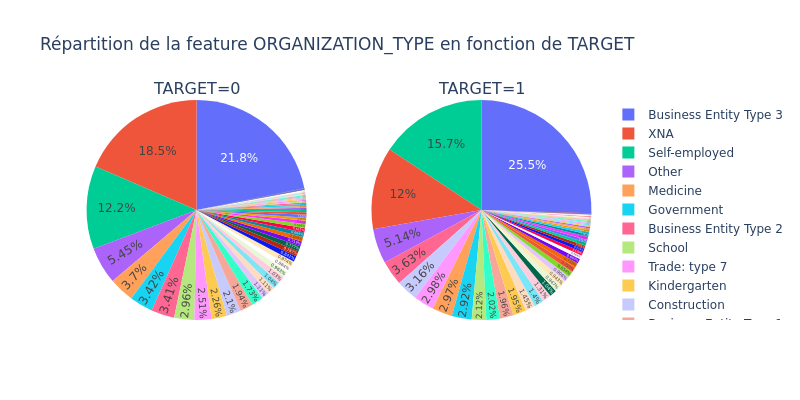

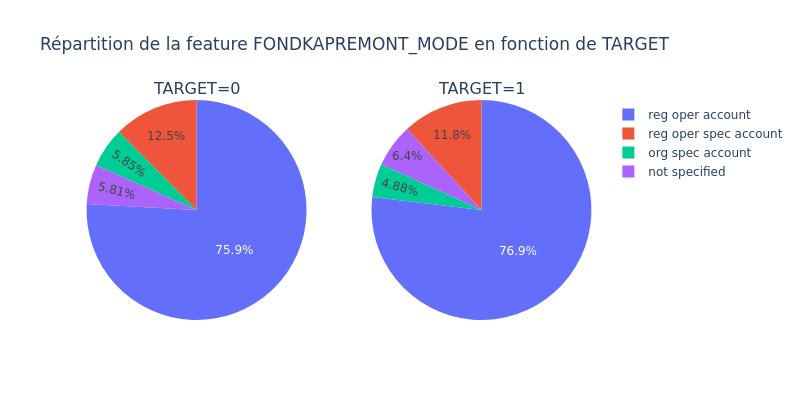

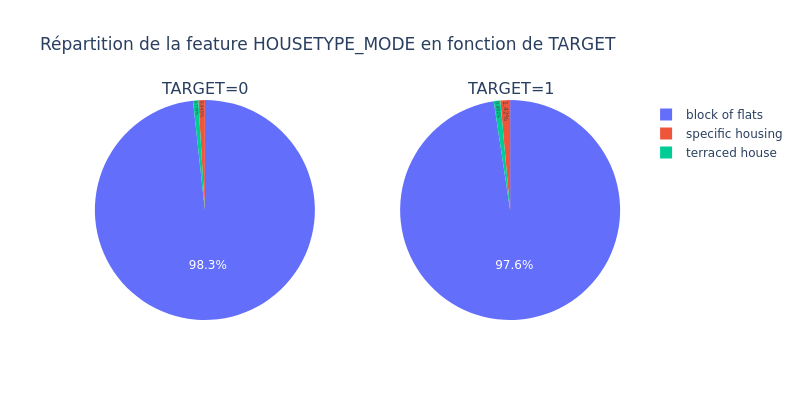

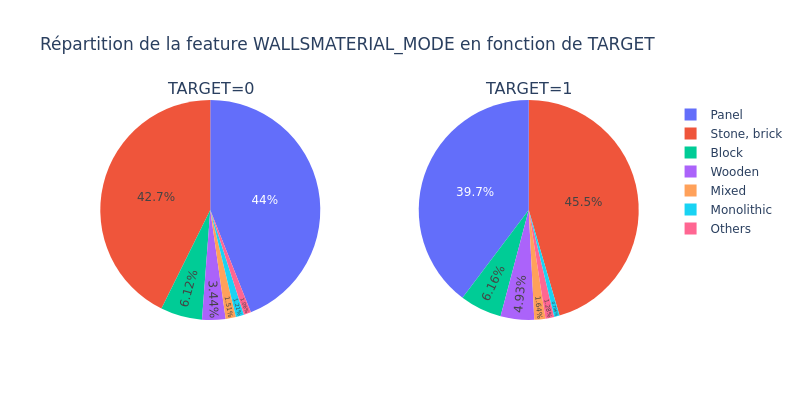

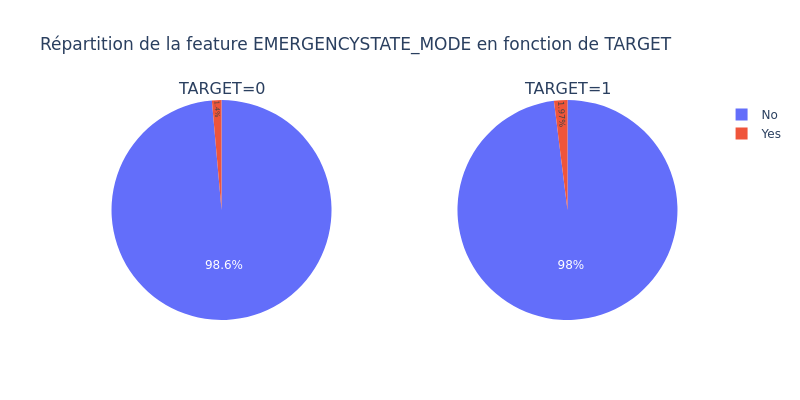

In [94]:
cat_cols = df_application.select_dtypes(include=[object]).columns
for y in range(1, len(cat_cols) + 1):
    fig = make_subplots(
        rows=1, 
        cols=2, 
        subplot_titles=((
            #"", "TOUS", 
            "TARGET=0", "TARGET=1")),
        specs=[[
            #{"type": "pie"}, {"type": "pie"}, 
            {"type": "pie"}, {"type": "pie"}]]
    )

    _parents = df_application["TARGET"].astype(str).unique().tolist()
    _parents0 = df_application["TARGET"].unique().tolist()
    labels = df_application["TARGET"].astype(str).unique().tolist()
    ids = df_application["TARGET"].astype(str).unique().tolist()
    values = []
    
    for p in _parents0:
        values.append(df_application.loc[df_application["TARGET"]==p].shape[0])

    """
    parents = [""] * len(_parents)
    for p in _parents0:
        for c in df_application.loc[(df_application["TARGET"]==p), cat_cols[y-1]].unique():
            values.append(df_application.loc[(df_application["TARGET"]==p) & (df_application[cat_cols[y-1]]==c)].shape[0])
            labels.append(f"{c}")
            ids.append(f"{c}_{p}")
            parents.append(p)

    fig.append_trace(go.Sunburst(
        ids = ids,
        labels=labels,
        parents=parents,
        values=values,
        branchvalues="total",
    ), row=1, col=1)
    """
            
    
    """
    vc = df_application.groupby(cat_cols[y-1]).count().reset_index()
    fig.append_trace(go.Pie(
        labels=vc.iloc[:,0], 
        values=vc.iloc[:,1],
        textposition='inside'
    ), row=1, col=2)
    """
    
    vc = df_application.loc[df_application["TARGET"]==0].groupby(cat_cols[y-1]).count().reset_index()
    fig.append_trace(go.Pie(
        labels=vc.iloc[:,0], 
        values=vc.iloc[:,1],
        textposition='inside'
    ), row=1, col=1)

    vc = df_application.loc[df_application["TARGET"]==1].groupby(cat_cols[y-1]).count().reset_index()
    fig.append_trace(go.Pie(
        labels=vc.iloc[:,0], 
        values=vc.iloc[:,1], 
        textposition='inside'
    ), row=1, col=2)
    
    fig.update_layout(height=400, width=800, title_text=f"Répartition de la feature {cat_cols[y-1]} en fonction de TARGET")
    fig.show()

Analysons les features numériques

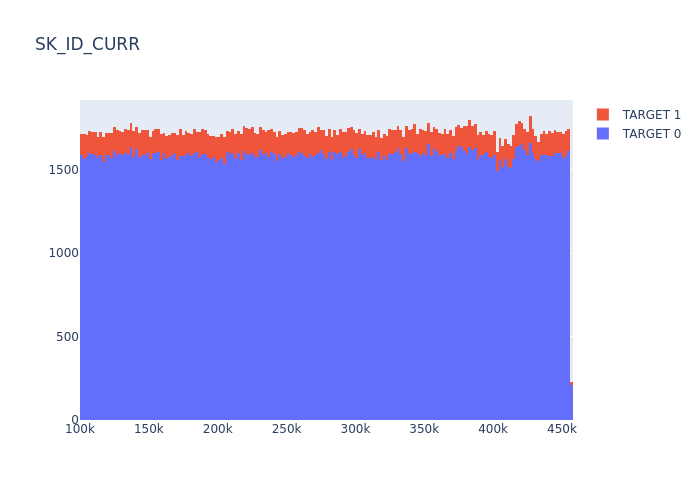

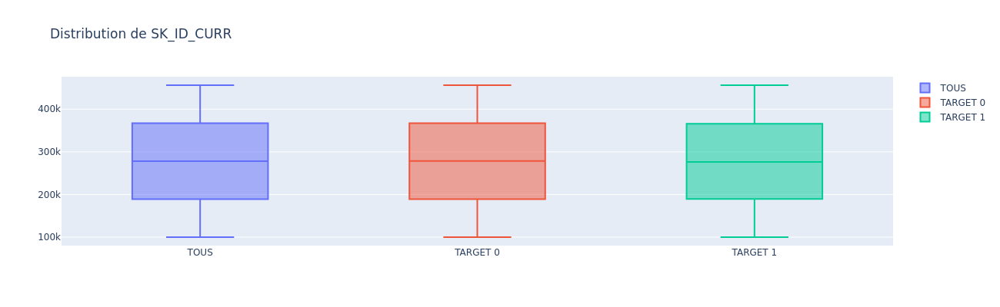

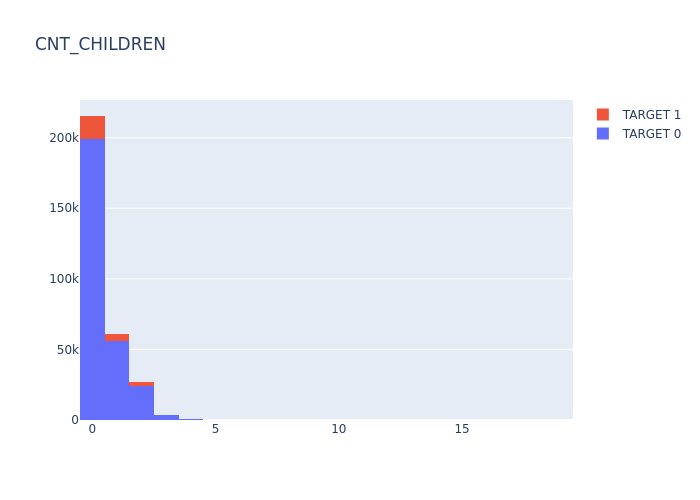

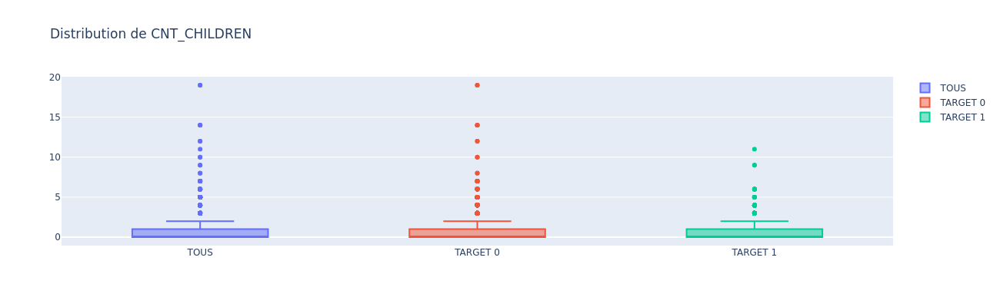

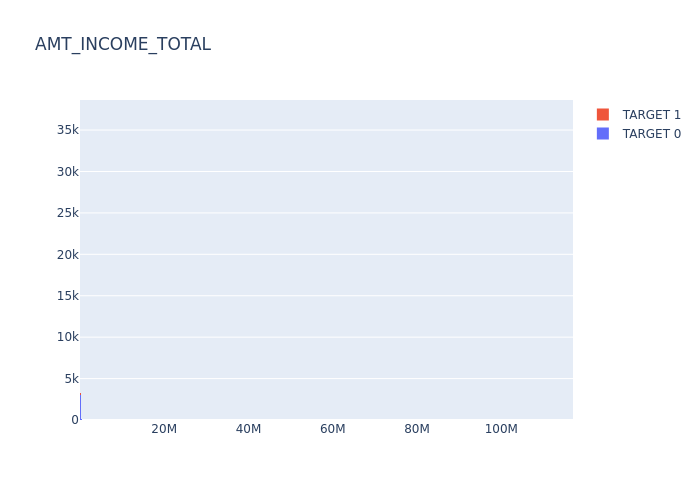

...

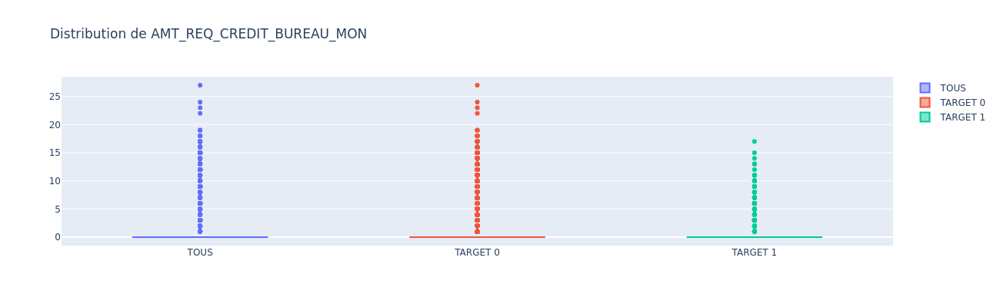

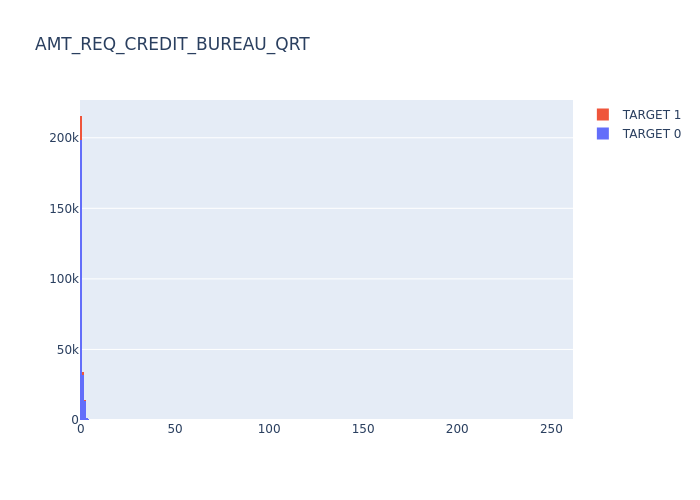

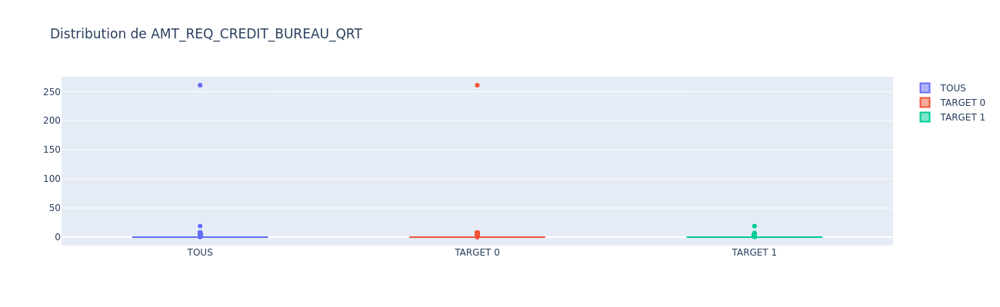

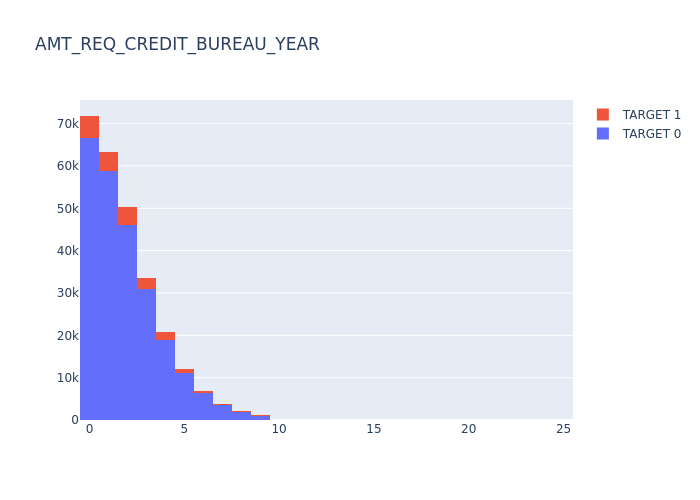

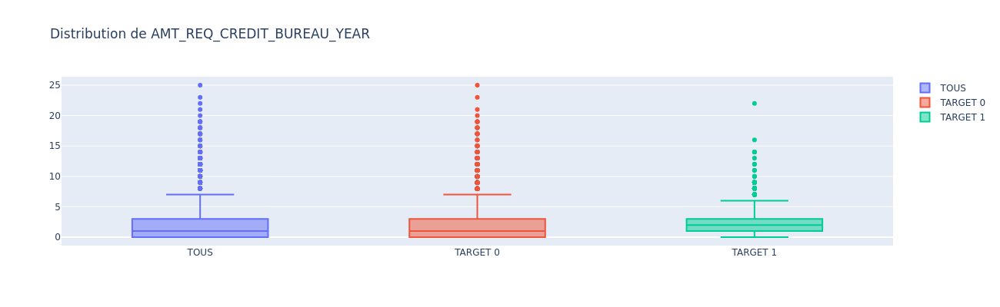

In [95]:
num_cols = df_application.select_dtypes(include=[int, float]).columns

for y in range(0, len(num_cols)):
    if num_cols[y]=="TARGET":
        continue
    #fig = make_subplots(rows=2, cols=2)
  
    fig = go.Figure()

    fig.add_trace(go.Histogram(x=df_application.loc[df_application["TARGET"]==0][num_cols[y]], name="TARGET 0"))
    fig.add_trace(go.Histogram(x=df_application.loc[df_application["TARGET"]==1][num_cols[y]], name="TARGET 1"))
    fig.update_layout(barmode='stack', title=num_cols[y])
    fig.show()

    fig = go.Figure()

    fig.add_trace(go.Box(y=df_application[num_cols[y]], name="TOUS"))
    
    fig.add_trace(go.Box(y=df_application.loc[df_application["TARGET"]==0][num_cols[y]], name="TARGET 0"))
    fig.add_trace(go.Box(y=df_application.loc[df_application["TARGET"]==1][num_cols[y]], name="TARGET 1"))
    
    fig.update_layout(height=400, width=1300, title_text=f"Distribution de {num_cols[y]}")
    
    fig.show()

<span style="color: red;">On constate des valeurs positives pour la feature DAYS_EMPLOYED alors qu'elles devraient toutes êtres inférieures ou égales à 0</span>

In [96]:
df_application.loc[df_application["DAYS_EMPLOYED"]>0, "DAYS_EMPLOYED"] = np.nan

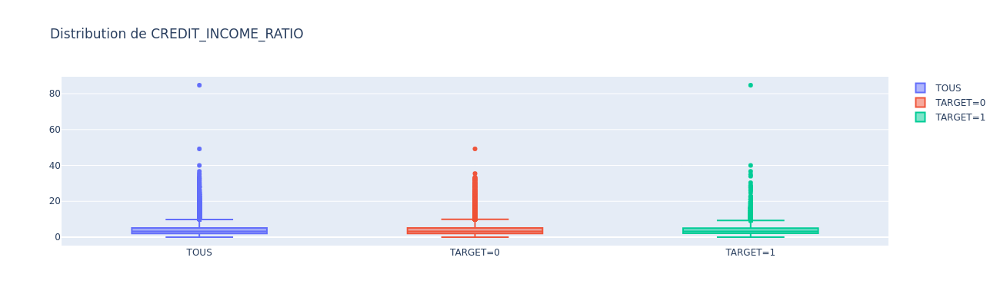

In [97]:
df_application["CREDIT_INCOME_RATIO"] = df_application["AMT_CREDIT"] / df_application["AMT_INCOME_TOTAL"]	

fig = go.Figure()

fig.add_trace(go.Box(y=df_application["CREDIT_INCOME_RATIO"], name="TOUS"))
fig.add_trace(go.Box(y=df_application.loc[df_application["TARGET"]==0]["CREDIT_INCOME_RATIO"], name="TARGET=0"))
fig.add_trace(go.Box(y=df_application.loc[df_application["TARGET"]==1]["CREDIT_INCOME_RATIO"], name="TARGET=1"))

fig.update_layout(height=400, width=1300, title_text=f"Distribution de CREDIT_INCOME_RATIO")
fig.show()

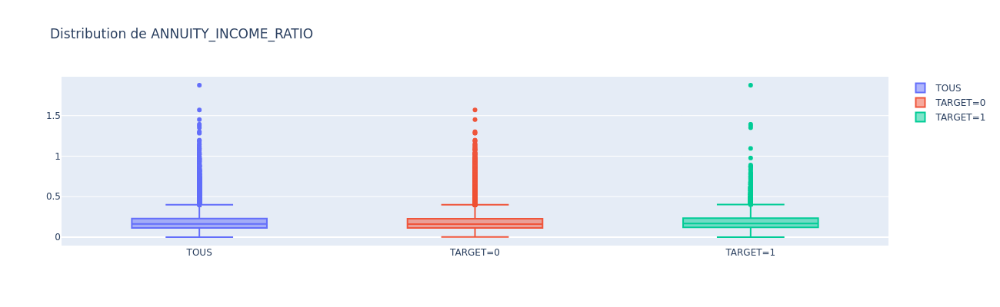

In [98]:
df_application["ANNUITY_INCOME_RATIO"] = df_application["AMT_ANNUITY"] / df_application["AMT_INCOME_TOTAL"]	
fig = go.Figure()

fig.add_trace(go.Box(y=df_application["ANNUITY_INCOME_RATIO"], name="TOUS"))
fig.add_trace(go.Box(y=df_application.loc[df_application["TARGET"]==0]["ANNUITY_INCOME_RATIO"], name="TARGET=0"))
fig.add_trace(go.Box(y=df_application.loc[df_application["TARGET"]==1]["ANNUITY_INCOME_RATIO"], name="TARGET=1"))

fig.update_layout(height=400, width=1300, title_text=f"Distribution de ANNUITY_INCOME_RATIO")
fig.show()

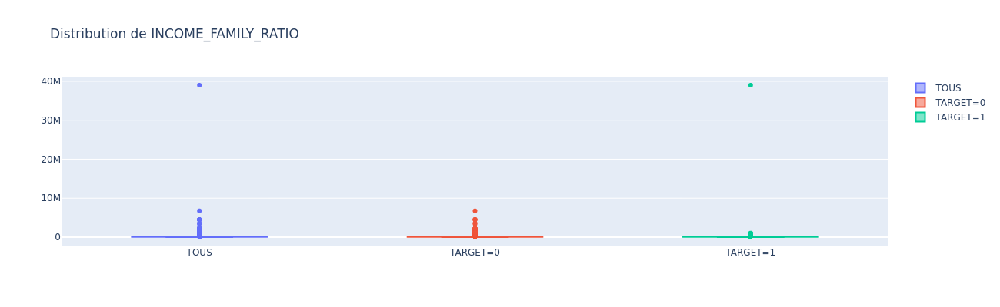

In [99]:
df_application["INCOME_FAMILY_RATIO"] = df_application["AMT_INCOME_TOTAL"] / df_application["CNT_FAM_MEMBERS"]	
fig = go.Figure()

fig.add_trace(go.Box(y=df_application["INCOME_FAMILY_RATIO"], name="TOUS"))
fig.add_trace(go.Box(y=df_application.loc[df_application["TARGET"]==0]["INCOME_FAMILY_RATIO"], name="TARGET=0"))
fig.add_trace(go.Box(y=df_application.loc[df_application["TARGET"]==1]["INCOME_FAMILY_RATIO"], name="TARGET=1"))

fig.update_layout(height=400, width=1300, title_text=f"Distribution de INCOME_FAMILY_RATIO")
fig.show()

In [100]:

df_application.sample(n=10).loc[:, [c for c in df_application.select_dtypes(include=np.number).columns.tolist() if c not in ['SK_ID_CURR']] ]

,TARGET,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OWN_CAR_AGE,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,APARTMENTS_AVG,BASEMENTAREA_AVG,YEARS_BEGINEXPLUATATION_AVG,YEARS_BUILD_AVG,COMMONAREA_AVG,ELEVATORS_AVG,ENTRANCES_AVG,FLOORSMAX_AVG,FLOORSMIN_AVG,LANDAREA_AVG,LIVINGAPARTMENTS_AVG,LIVINGAREA_AVG,NONLIVINGAPARTMENTS_AVG,NONLIVINGAREA_AVG,APARTMENTS_MODE,BASEMENTAREA_MODE,YEARS_BEGINEXPLUATATION_MODE,YEARS_BUILD_MODE,COMMONAREA_MODE,ELEVATORS_MODE,ENTRANCES_MODE,FLOORSMAX_MODE,FLOORSMIN_MODE,LANDAREA_MODE,LIVINGAPARTMENTS_MODE,LIVINGAREA_MODE,NONLIVINGAPARTMENTS_MODE,NONLIVINGAREA_MODE,APARTMENTS_MEDI,BASEMENTAREA_MEDI,YEARS_BEGINEXPLUATATION_MEDI,YEARS_BUILD_MEDI,COMMONAREA_MEDI,ELEVATORS_MEDI,ENTRANCES_MEDI,FLOORSMAX_MEDI,FLOORSMIN_MEDI,LANDAREA_MEDI,LIVINGAPARTMENTS_MEDI,LIVINGAREA_MEDI,NONLIVINGAPARTMENTS_MEDI,NONLIVINGAREA_MEDI,TOTALAREA_MODE,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR,CREDIT_INCOME_RATIO,ANNUITY_INCOME_RATIO,INCOME_FAMILY_RATIO
46148,0,0,292500.0,592560.0,35937.0,450000.0,0.007020,-10197,-2646.0,-10196.0,-2694,1.0,1,1,0,1,1,0,2.0,2,2,13,0,0,0,0,1,1,NaN,0.453325,0.181959,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,7.0,0.0,7.0,0.0,0.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,1.0,0.0,0.0,2.025846,0.122862,146250.0
206564,1,0,202500.0,675000.0,37692.0,675000.0,0.022625,-16985,-2201.0,-245.0,-519,11.0,1,1,1,1,1,0,2.0,2,2,16,0,0,0,0,0,0,0.765651,0.457241,0.408359,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,0.0,1.0,0.0,-512.0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0,3.333333,0.186133,101250.0
199289,0,0,162000.0,544491.0,17694.0,454500.0,0.020713,-17001,-1383.0,-2196.0,-546,14.0,1,1,1,1,1,0,2.0,3,3,8,0,0,0,0,0,0,0.544112,0.391754,0.260856,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,0.0,0.0,-2135.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,1.0,0.0,0.0,3.0,3.361056,0.109222,81000.0
142077,0,0,45000.0,135000.0,14179.5,135000.0,0.028663,-23365,NaN,-12523.0,-4082,NaN,1,0,0,1,0,0,2.0,2,2,9,0,0,0,0,0,0,NaN,0.656547,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,3.0,0.0,3.0,0.0,-362.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,3.000000,0.315100,22500.0
135913,0,0,202500.0,450000.0,22500.0,450000.0,0.019689,-10506,-1175.0,-870.0,-2218,NaN,1,1,0,1,0,0,2.0,2,2,12,0,0,0,0,0,0,NaN,0.318124,NaN,0.1412,0.0068,0.9771,0.6872,0.0199,0.0,0.2759,0.1667,0.2083,0.1127,0.1152,0.1136,0.0,0.0,0.1439,0.0070,0.9772,0.6994,0.0201,0.0,0.2759,0.1667,0.2083,0.1152,0.1258,0.1184,0.0,0

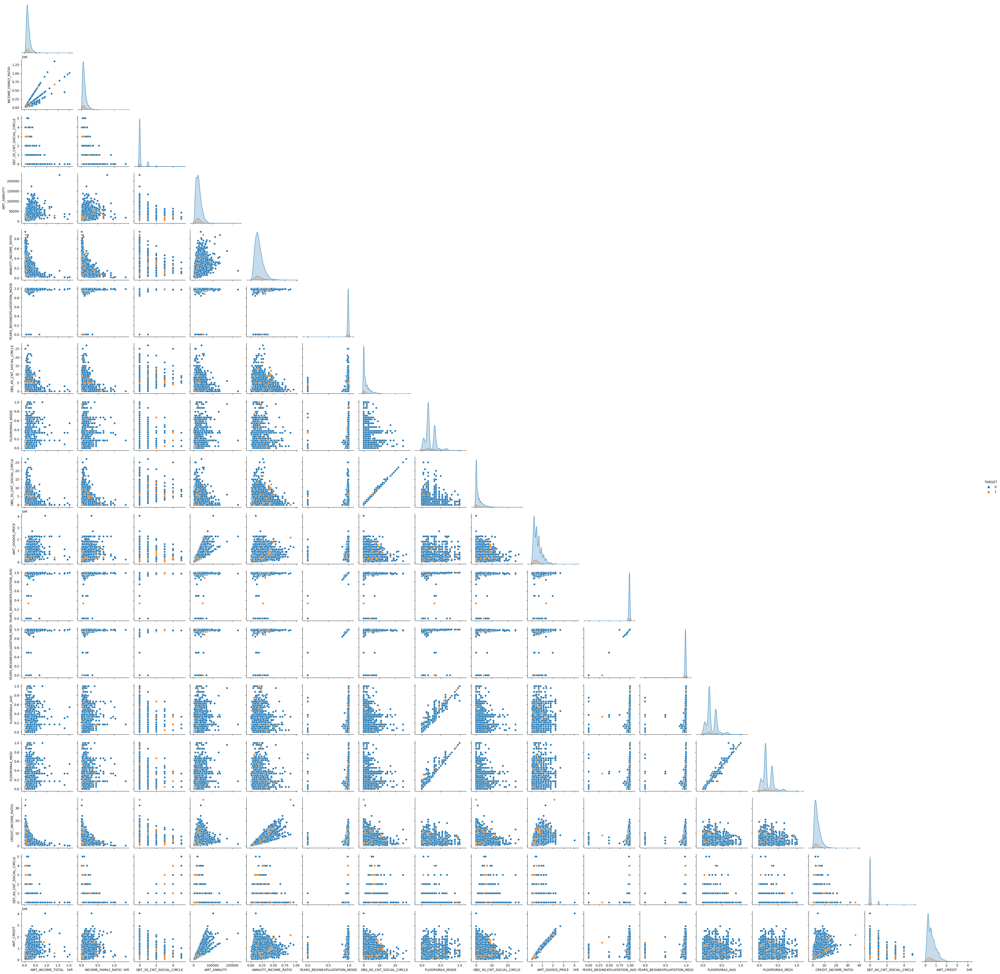

In [101]:

num_cols = [c for c in df_application.drop(columns=cols_to_remove["application_train"]).select_dtypes(include=np.float64).columns.tolist() if c not in ['SK_ID_CURR']]
df_application2 = df_application.drop(columns=cols_to_remove["application_train"]).dropna()
relations = []
for c in num_cols:
    df2 = df_application2.loc[:, [x for x in num_cols if x!=c]]
    r = r_regression(df2, df_application2[c])
    for i in range(0, len(r)):
        if r[i]>0.7:
            relations.append(c)
            relations.append(df2.columns[i])

relations.append("TARGET")
relations = list(set(relations))

if len(relations)>0:
    sns.pairplot(
        df_application.sample(n=15000).loc[:, relations ],
        dropna=True,
        hue="TARGET",
        corner=True
    )
    plt.show()
else:
    print("pas de relation linéaire détectée")

Relation linéaire forte entre OBS_30_CNT_SOCIAL_CIRCLE et OBS_60_CNT_SOCIAL_CIRCLE ainsi qu'entre AMT_CREDIT et AMT_GOODS_PRICE

In [102]:
del df_application
gc.collect()

813

# application_test

In [119]:
df_application_test = pd.read_csv("../assets/application_test.csv")

In [104]:
df_application_test.info(verbose=True)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 48744 entries, 0 to 48743
Data columns (total 121 columns):
 #    Column                        Dtype  
---   ------                        -----  
 0    SK_ID_CURR                    int64  
 1    NAME_CONTRACT_TYPE            object 
 2    CODE_GENDER                   object 
 3    FLAG_OWN_CAR                  object 
 4    FLAG_OWN_REALTY               object 
 5    CNT_CHILDREN                  int64  
 6    AMT_INCOME_TOTAL              float64
 7    AMT_CREDIT                    float64
 8    AMT_ANNUITY                   float64
 9    AMT_GOODS_PRICE               float64
 10   NAME_TYPE_SUITE               object 
 11   NAME_INCOME_TYPE              object 
 12   NAME_EDUCATION_TYPE           object 
 13   NAME_FAMILY_STATUS            object 
 14   NAME_HOUSING_TYPE             object 
 15   REGION_POPULATION_RELATIVE    float64
 16   DAYS_BIRTH                    int64  
 17   DAYS_EMPLOYED                 int64  
 18   DAYS

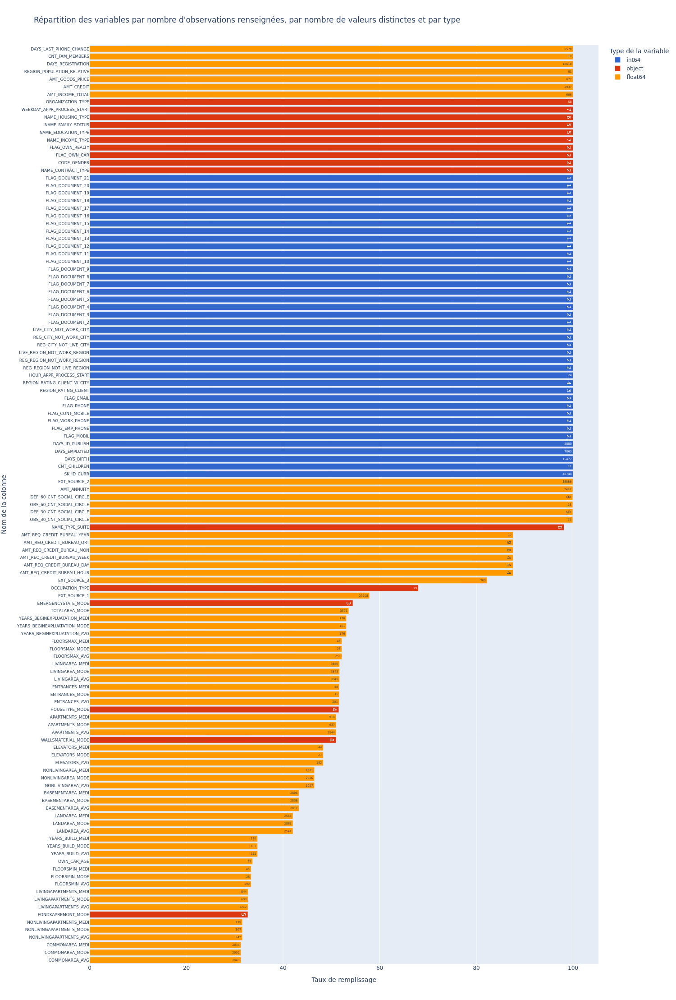

In [105]:
show_df_info_bar(df_application_test, width=1500)

In [106]:
df_info = get_df_info(df_application_test)
if "application_test" not in cols_to_remove:
    cols_to_remove["application_test"] = []
if df_info.loc[df_info["filled_ratio"]<filled_ratio_threshold, "column"].shape[0]>0:
    for c in df_info.loc[df_info["filled_ratio"]<filled_ratio_threshold, "column"]:
        cols_to_remove["application_test"].append(c)

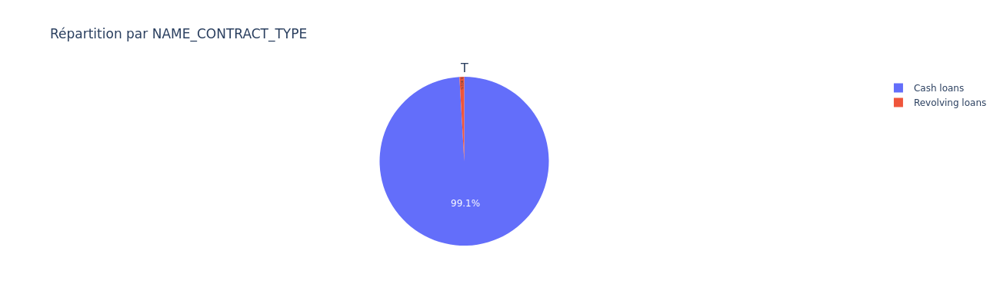

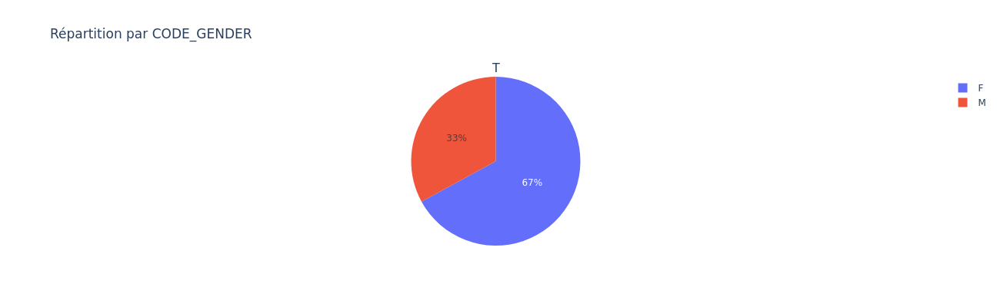

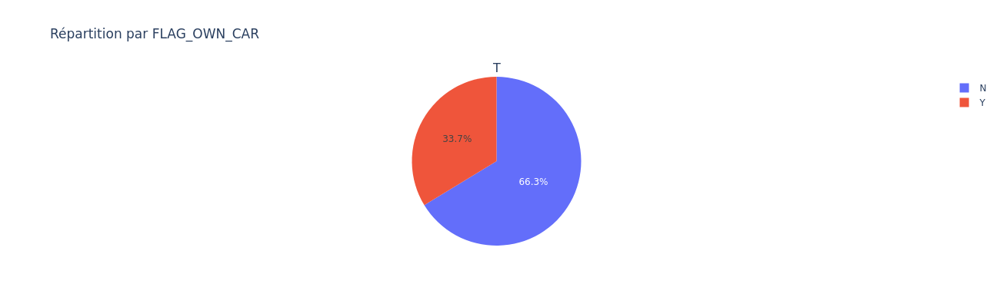

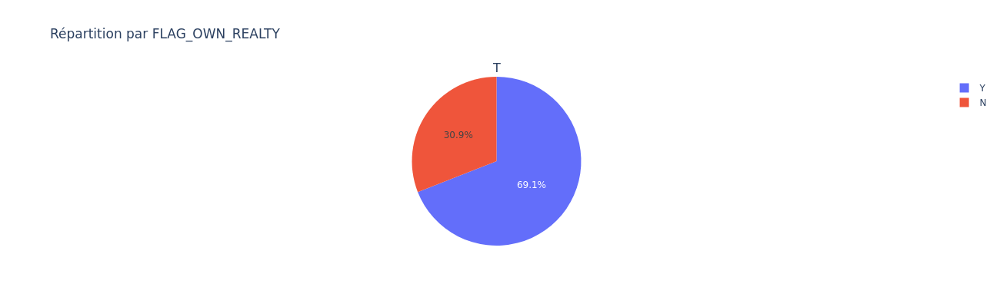

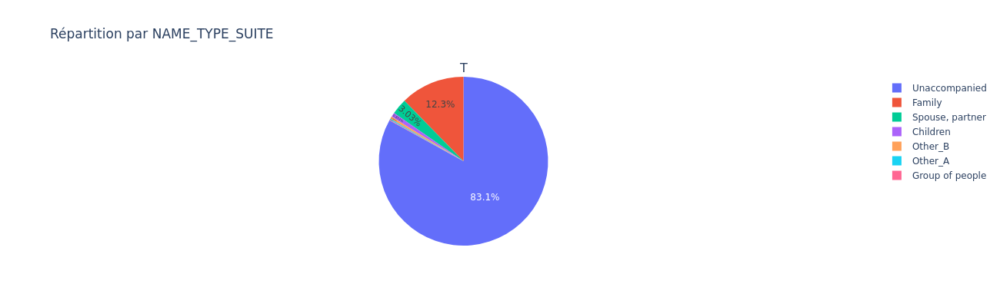

...

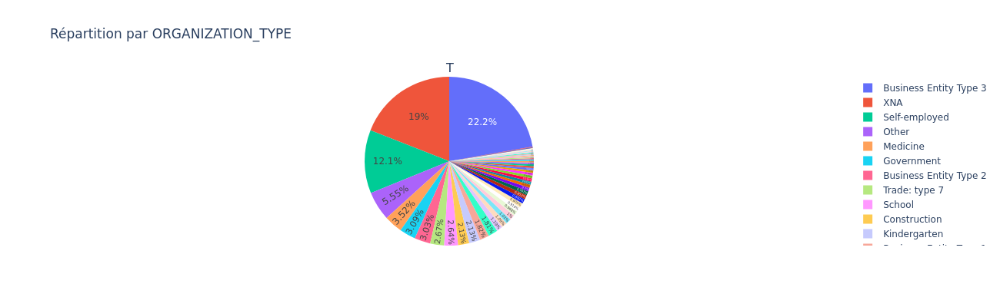

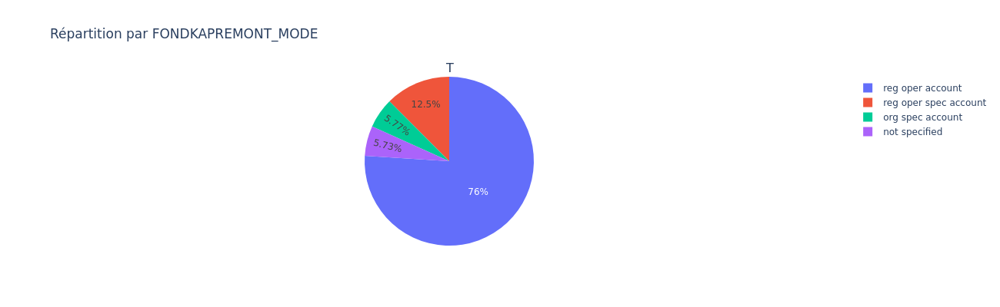

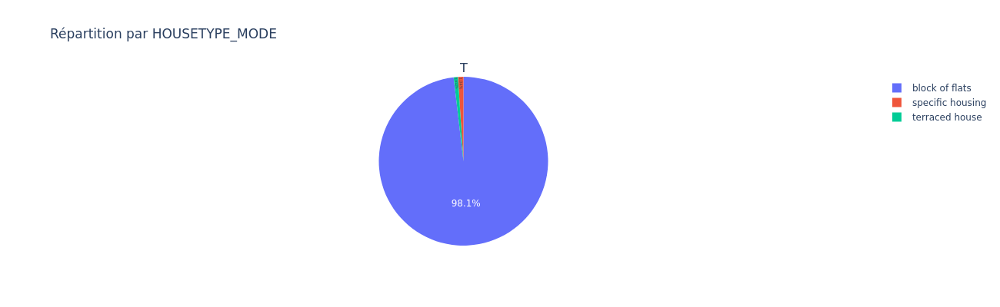

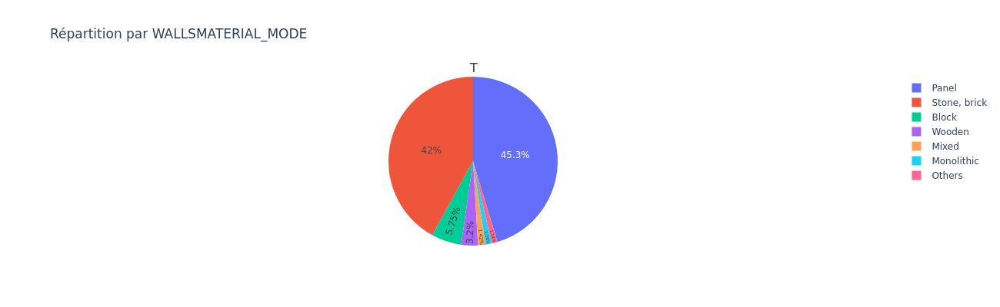

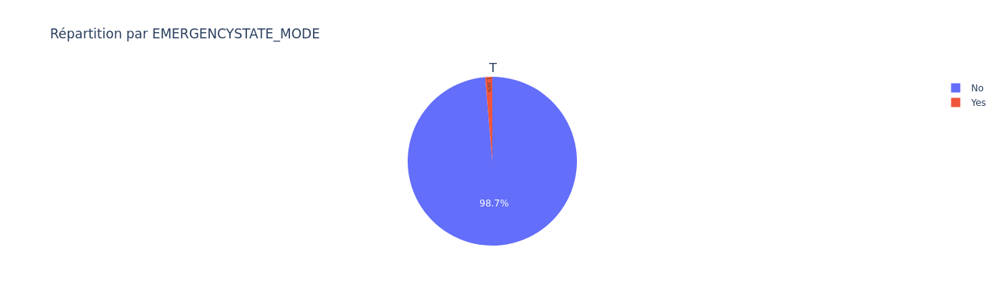

In [107]:
cat_cols = df_application_test.select_dtypes(include=[object]).columns
for y in range(1, len(cat_cols) + 1):
    fig = make_subplots(
        rows=1, 
        cols=1, 
        subplot_titles=("TOUS"),
        specs=[[{"type": "pie"}]]
    )


            
    
    vc = df_application_test.groupby(cat_cols[y-1]).count().reset_index()
    fig.append_trace(go.Pie(
        labels=vc.iloc[:,0], 
        values=vc.iloc[:,1],
        textposition='inside'
    ), row=1, col=1)

    
    fig.update_layout(height=400, width=1300, title_text=f"Répartition par {cat_cols[y-1]}")
    fig.show()

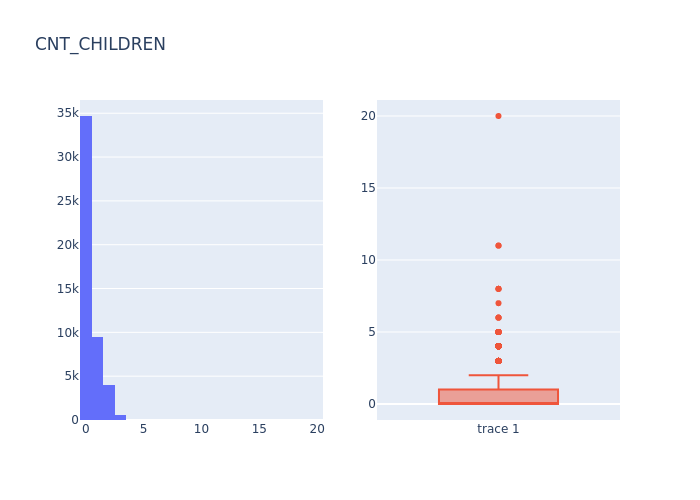

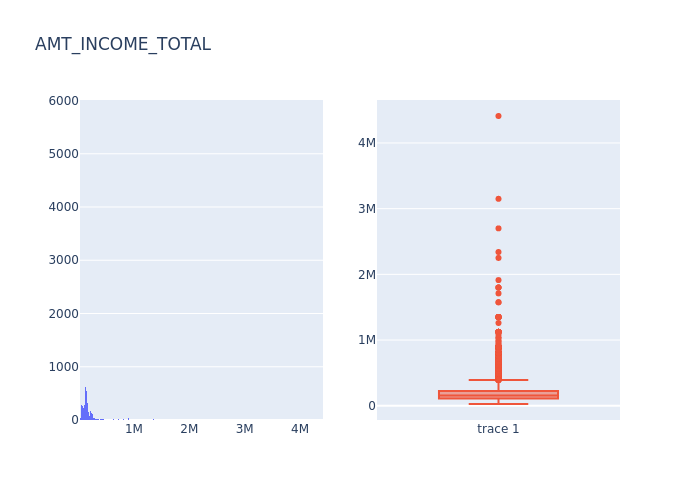

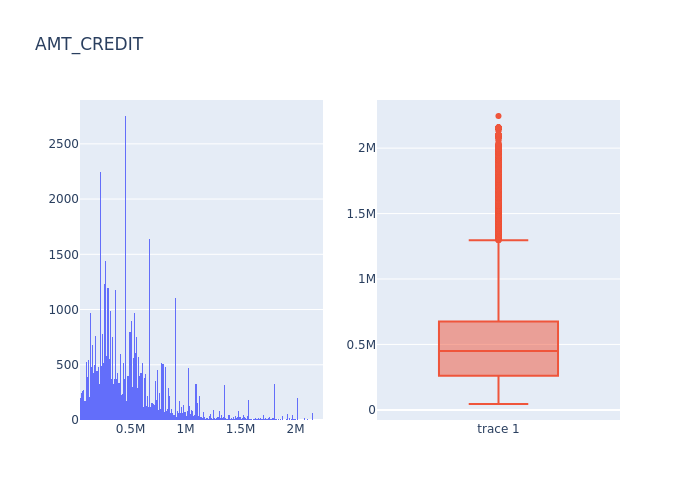

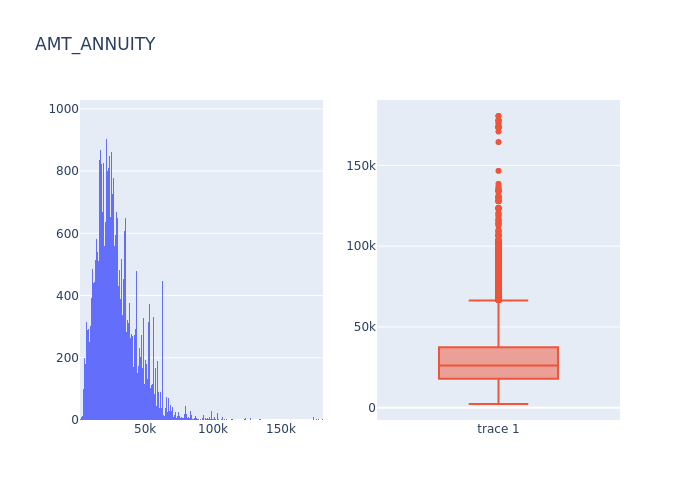

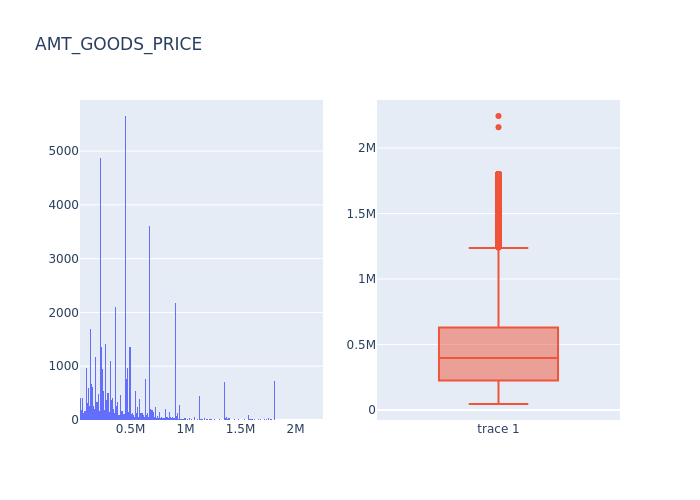

...

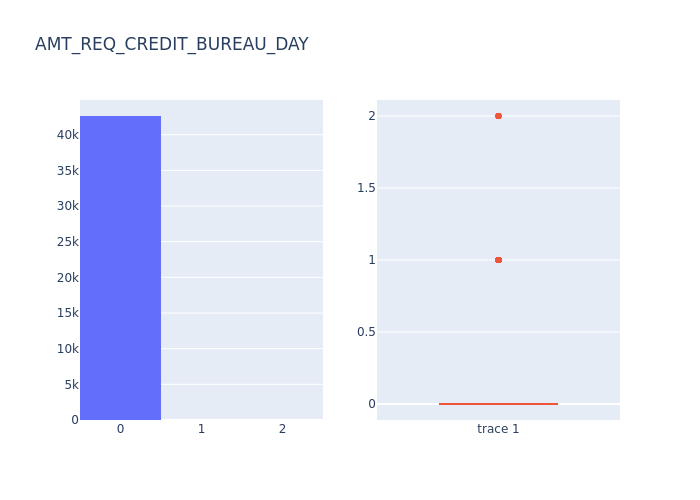

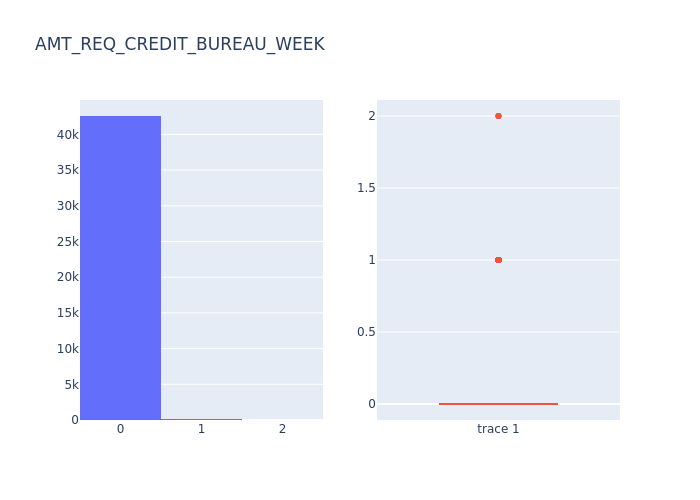

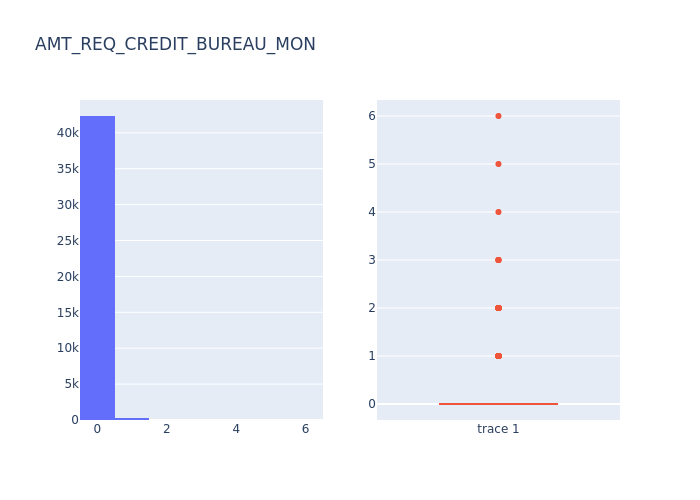

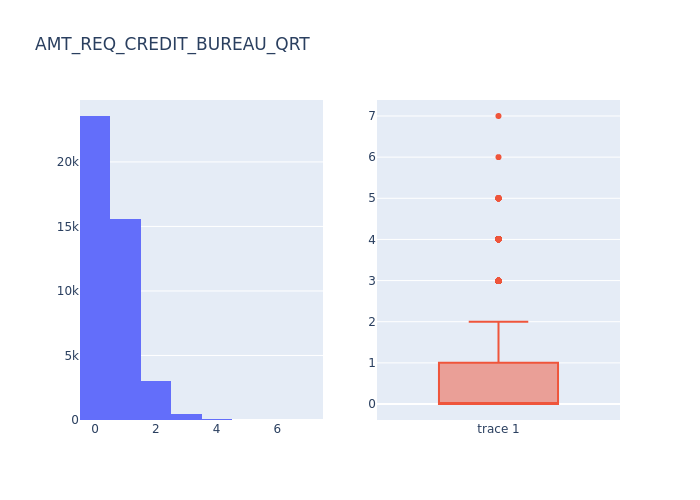

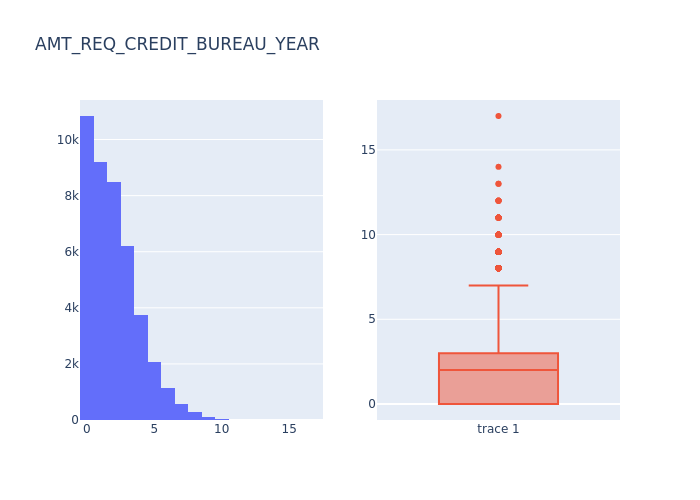

In [108]:
num_cols = df_application_test.select_dtypes(include=[int, float]).columns

for y in range(0, len(num_cols)):
    if num_cols[y]=="TARGET" or num_cols[y]=="SK_ID_CURR":
        continue
    fig = make_subplots(rows=1, cols=2)
  
    #fig = go.Figure()

    fig.add_trace(go.Histogram(x=df_application_test[num_cols[y]] ), row=1, col=1)
    fig.add_trace(go.Box(y=df_application_test[num_cols[y]], ), row=1, col=2)
    fig.update_layout(title=num_cols[y], showlegend=False)
    fig.show()

    #fig = go.Figure()

    #fig.add_trace(go.Box(y=df_application_test[num_cols[y]]))
    
    #fig.update_layout(height=400, width=1300, title_text=f"Distribution de {num_cols[y]}")
    
    #fig.show()

<span style="color: red;">On constate des valeurs positives pour la feature DAYS_EMPLOYED alors qu'elles devraient toutes êtres inférieures ou égales à 0</span>

In [109]:
df_application_test.loc[df_application_test["DAYS_EMPLOYED"]>0, "DAYS_EMPLOYED"] = np.nan

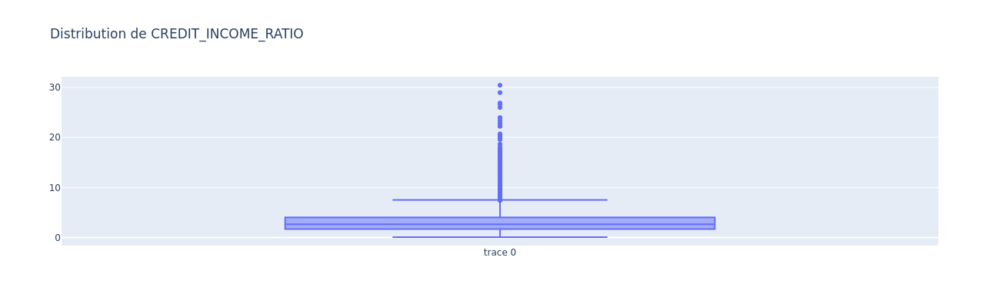

In [110]:
df_application_test["CREDIT_INCOME_RATIO"] = df_application_test["AMT_CREDIT"] / df_application_test["AMT_INCOME_TOTAL"]	

fig = go.Figure()

fig.add_trace(go.Box(y=df_application_test["CREDIT_INCOME_RATIO"]))

fig.update_layout(height=400, width=1300, title_text=f"Distribution de CREDIT_INCOME_RATIO")
fig.show()

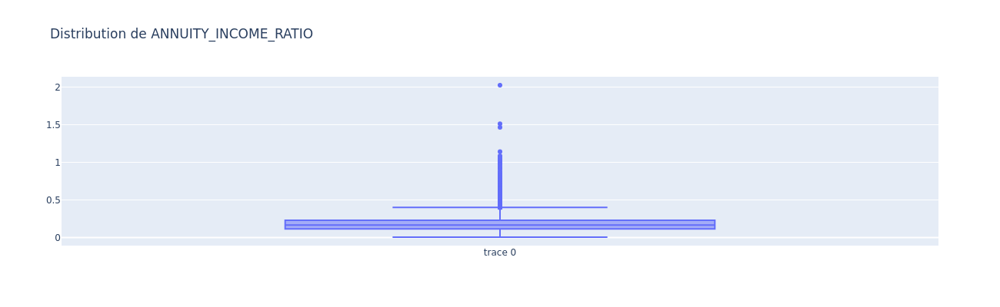

In [111]:
df_application_test["ANNUITY_INCOME_RATIO"] = df_application_test["AMT_ANNUITY"] / df_application_test["AMT_INCOME_TOTAL"]	
fig = go.Figure()

fig.add_trace(go.Box(y=df_application_test["ANNUITY_INCOME_RATIO"]))

fig.update_layout(height=400, width=1300, title_text=f"Distribution de ANNUITY_INCOME_RATIO")
fig.show()

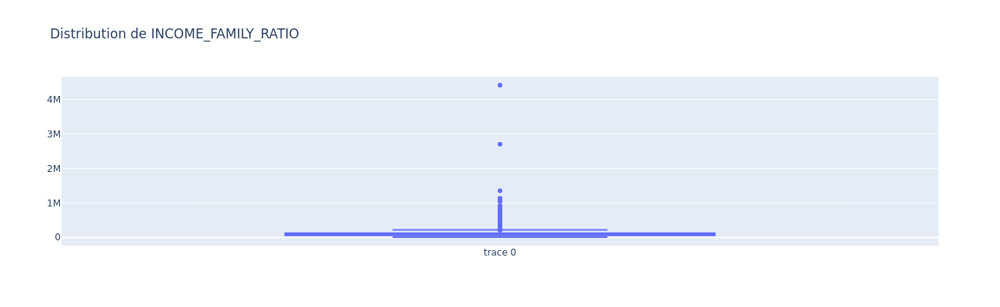

In [112]:
df_application_test["INCOME_FAMILY_RATIO"] = df_application_test["AMT_INCOME_TOTAL"] / df_application_test["CNT_FAM_MEMBERS"]	
fig = go.Figure()

fig.add_trace(go.Box(y=df_application_test["INCOME_FAMILY_RATIO"]))

fig.update_layout(height=400, width=1300, title_text=f"Distribution de INCOME_FAMILY_RATIO")
fig.show()



Vérifions s'il existe comme dans application_train une relation linéaire forte entre OBS_30_CNT_SOCIAL_CIRCLE et OBS_60_CNT_SOCIAL_CIRCLE

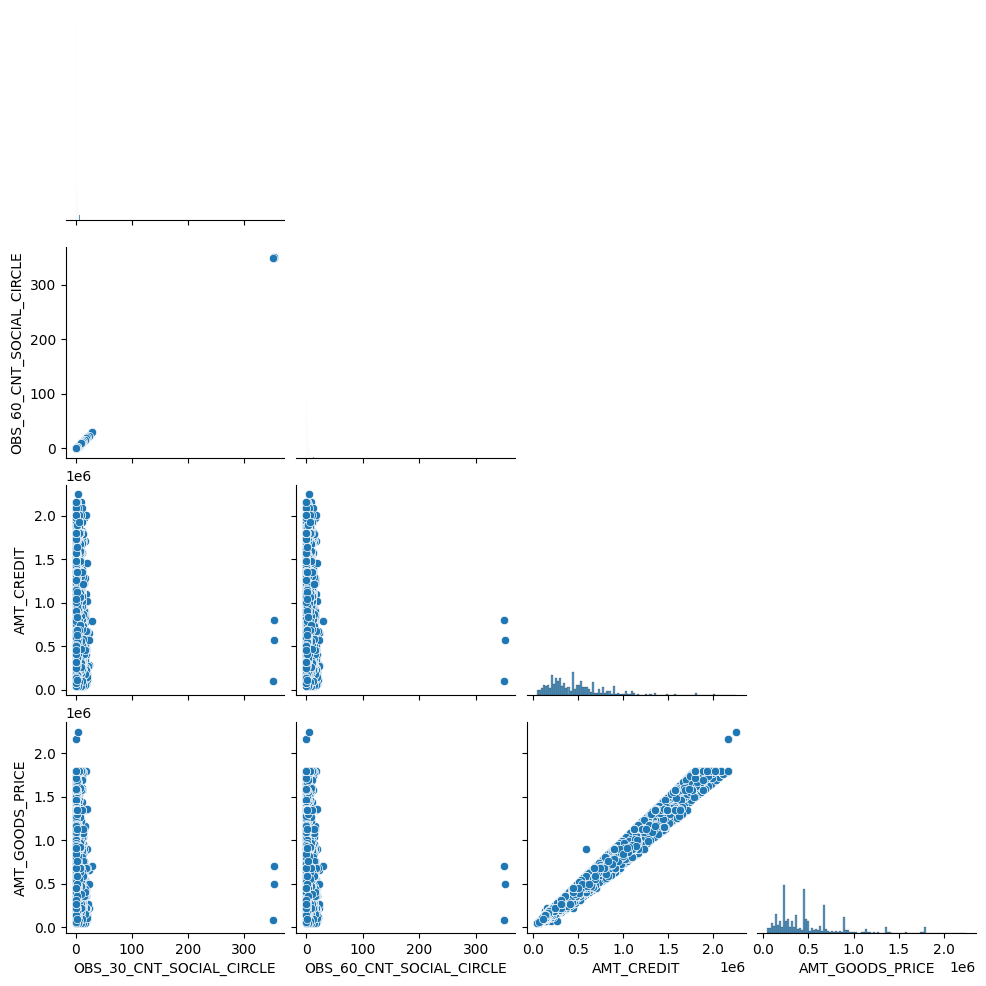

In [120]:
sns.pairplot(
    df_application_test.loc[:, ["OBS_30_CNT_SOCIAL_CIRCLE", "OBS_60_CNT_SOCIAL_CIRCLE", "AMT_CREDIT", "AMT_GOODS_PRICE"]],
    dropna=True,
    corner=True
)
plt.show()

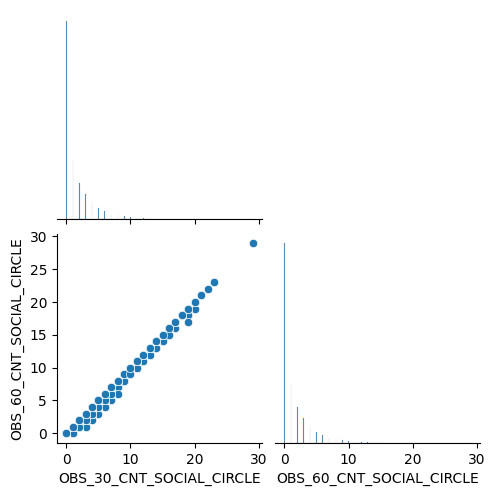

In [114]:
sns.pairplot(
    df_application_test.loc[df_application_test["OBS_30_CNT_SOCIAL_CIRCLE"]<100, ["OBS_30_CNT_SOCIAL_CIRCLE", "OBS_60_CNT_SOCIAL_CIRCLE"]],
    dropna=True,
    corner=True
)
plt.show()

Comme pour application_train, nous avons une relation linéaire forte entre OBS_30_CNT_SOCIAL_CIRCLE et OBS_60_CNT_SOCIAL_CIRCLE

In [115]:
del df_application_test
gc.collect()

347

In [116]:
if not os.path.isdir("../working"):
    os.mkdir("../working")
    
with open("../working/columns_to_remove.json", "w") as outfile:
    outfile.write(json.dumps(cols_to_remove, indent=4))
    

# Conclusion

In [117]:
nb_total_features

255

On a 218 features originales différentes réparties dans 7 fichiers.

On constate la présence de valeurs non renseignées assez importante, même après avoir enlevé les features non renseignées à moins de 50%.

On voit quelques relations linéaires entre features d'une même table.

Certaines valeurs sont abérrantes et peuvent être facilement corrigées.

Il n'y a pas de relation 1:1 entre les différentes tables, mais plutôt des relations 0:n

Pour la table credit_card_balance, relations linéaires fortes 
- entre AMT_BALANCE et AMT_TOTAL_RECEIVABLE, AMT_RECEIVABLE_PRINCIPAL, AMT_RECIVABLE 
- et entre AMT_PAYMENT_CURRENT et AMT_PAYMENT_TOTAL_CURRENT

Pour la table installment_payments: relations linéaires fortes entre :
- DAYS_INSTALMENT et DAYS_ENTRY_PAYMENT
- AMT_INSTALMENT et AMT_PAYMENT

Pour la table previous_applications, fortes relations linéaires entre:
- AMT_CREDIT, AMT_APPLICATION et AMT_GOODS_PRICE 
- DAYS_DECISION et DAYS_FIRST_DUE

Pour les tables application_train et application_test, relation linéaire forte entre OBS_30_CNT_SOCIAL_CIRCLE et OBS_60_CNT_SOCIAL_CIRCLE ainsi qu'entre AMT_CREDIT et AMT_GOODS_PRICE